In [ ]:
!pip install torchmetrics
from __future__ import print_function
import argparse
import os
import random
import numpy as np

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.nn.functional as F
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.autograd import Variable
from torchmetrics.classification import BinaryAccuracy
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook as tqdm
import tqdm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install patool
import patoolib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
patoolib.extract_archive("/content/Dataset.zip")

patool: Extracting /content/Dataset.zip ...
patool: running /usr/bin/7z x -o./Unpack_mhhteerx -- /content/Dataset.zip
patool: ... /content/Dataset.zip extracted to `Dataset1' (local file exists).


'Dataset1'

In [ ]:
import torch
from PIL import Image
import torchvision.transforms as transforms
import os
from os import listdir
from pathlib import Path
import glob

In [ ]:
num_epochs = 300
lr = 0.001
n_class = 5

In [ ]:
dataset = dset.ImageFolder(root="/content/Dataset",
                           transform=transforms.Compose([
                               transforms.Resize(64),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

In [ ]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=32,shuffle=True, num_workers=4)

/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda:0" if use_cuda else "cpu")

In [ ]:
class Generator(nn.Module):

    def __init__(self,n_class=5):

        super(Generator, self).__init__()
        self.ReLU = nn.ReLU(True)
        self.Tanh = nn.Tanh()
        self.conv1 = nn.ConvTranspose2d(133, 64 * 8, 4, 1, 0, bias=False)
        self.BatchNorm1 = nn.BatchNorm2d(64 * 8)
        self.conv2 = nn.ConvTranspose2d(64 * 8, 64 * 4, 4, 2, 1, bias=False)
        self.BatchNorm2 = nn.BatchNorm2d(64 * 4)
        self.conv3 = nn.ConvTranspose2d(64 * 4, 64 * 2, 4, 2, 1, bias=False)
        self.BatchNorm3 = nn.BatchNorm2d(64 * 2)
        self.conv4 = nn.ConvTranspose2d(64 * 2, 64 * 1, 4, 2, 1, bias=False)
        self.BatchNorm4 = nn.BatchNorm2d(64 * 1)
        self.conv5 = nn.ConvTranspose2d(64 * 1, 3, 4, 2, 1, bias=False)
        self.apply(weights_init)

    def forward(self, input):

        x = self.conv1(input)
        x = self.BatchNorm1(x)
        x = self.ReLU(x)
        x = self.conv2(x)
        x = self.BatchNorm2(x)
        x = self.ReLU(x)
        x = self.conv3(x)
        x = self.BatchNorm3(x)
        x = self.ReLU(x)
        x = self.conv4(x)
        x = self.BatchNorm4(x)
        x = self.ReLU(x)
        x = self.conv5(x)
        output = self.Tanh(x)
        return output
netG = Generator(1).to(device)
netG.apply(weights_init)
print(netG)

Generator(
  (ReLU): ReLU(inplace=True)
  (Tanh): Tanh()
  (conv1): ConvTranspose2d(133, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (BatchNorm1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (BatchNorm2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (BatchNorm3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (BatchNorm4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
)


In [ ]:
class Discriminator(nn.Module):

    def __init__(self,n_class=5):

        super(Discriminator, self).__init__()
        self.LeakyReLU = nn.LeakyReLU(0.2, inplace=True)
        self.conv1 = nn.Conv2d(3, 64, 4, 2, 1, bias=False)
        self.conv2 = nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False)
        self.BatchNorm2 = nn.BatchNorm2d(64 * 2)
        self.conv3 = nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False)
        self.BatchNorm3 = nn.BatchNorm2d(64 * 4)
        self.conv4 = nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False)
        self.BatchNorm4 = nn.BatchNorm2d(64 * 8)
        self.conv5 = nn.Conv2d(64 * 8, 64 * 1, 4, 1, 0, bias=False)
        self.disc_linear = nn.Linear(64 * 1, 1)
        self.aux_linear = nn.Linear(64 * 1, n_class)
        self.softmax = nn.Softmax()
        self.sigmoid = nn.Sigmoid()
        self.apply(weights_init)
        
    def forward(self, input):
            x = self.conv1(input)
            x = self.LeakyReLU(x)
            x = self.conv2(x)
            x = self.BatchNorm2(x)
            x = self.LeakyReLU(x)
            x = self.conv3(x)
            x = self.BatchNorm3(x)
            x = self.LeakyReLU(x)
            x = self.conv4(x)
            x = self.BatchNorm4(x)
            x = self.LeakyReLU(x)
            x = self.conv5(x)
            x = x.view(-1, 64 * 1)
            c = self.aux_linear(x)
            c = self.softmax(c)
            s = self.disc_linear(x)
            s = self.sigmoid(s)
            return s,c

netD = Discriminator(1).to(device)
netD.apply(weights_init)
print(netD)

Discriminator(
  (LeakyReLU): LeakyReLU(negative_slope=0.2, inplace=True)
  (conv1): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (BatchNorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (BatchNorm3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (BatchNorm4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(512, 64, kernel_size=(4, 4), stride=(1, 1), bias=False)
  (disc_linear): Linear(in_features=64, out_features=1, bias=True)
  (aux_linear): Linear(in_features=64, out_features=1, bias=True)
  (softmax): Softmax(dim=None)
  (sigmoid): Sigmoid()
)


In [ ]:
optimizerD = optim.Adam(netD.parameters(), lr=0.001, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.001, betas=(0.5, 0.999))
s_criterion = nn.BCELoss() #realfake
c_criterion = nn.NLLLoss() #class
metricAcc=BinaryAccuracy()
r_label = 0.7
f_label = 0

In [ ]:
# input = torch.tensor([32, 3, 64, 64], device=device)
# noise = torch.tensor([32, 128, 1, 1], device=device)

# fixed_noise = torch.randn(1, 128, 1, 1, device=device)
# fixed_label = torch.randint(0, n_class, (1, ), device=device)
# onehot_label = torch.eye(n_class, device=device) [fixed_label].view(-1, n_class, 1, 1)
# fixed_noise_label = torch.cat((fixed_noise, onehot_label), dim=1)

Training Loop

  0%|          | 0/32 [00:00<?, ?it/s]

<ipython-input-11-e4f4a713494f>:36: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  c = self.softmax(c)


[1/300]
Loss_D: 2.5566	Loss_G: 7.8630



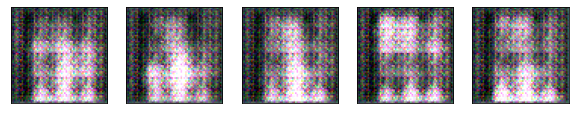

  0%|          | 0/32 [00:00<?, ?it/s]

[2/300]
Loss_D: 1.0502	Loss_G: 2.6097



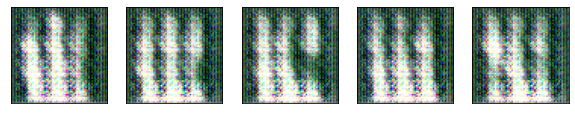

  0%|          | 0/32 [00:00<?, ?it/s]

[3/300]
Loss_D: 0.8053	Loss_G: 0.7398



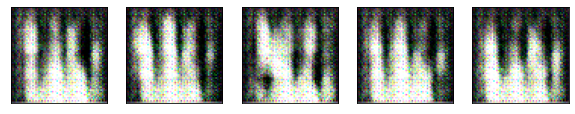

  0%|          | 0/32 [00:00<?, ?it/s]

[4/300]
Loss_D: 0.8985	Loss_G: 0.3701



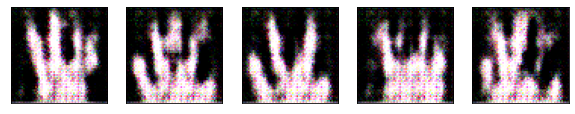

  0%|          | 0/32 [00:00<?, ?it/s]

[5/300]
Loss_D: 1.0164	Loss_G: 0.7581



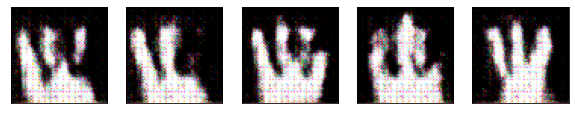

  0%|          | 0/32 [00:00<?, ?it/s]

[6/300]
Loss_D: 0.9483	Loss_G: 0.5997



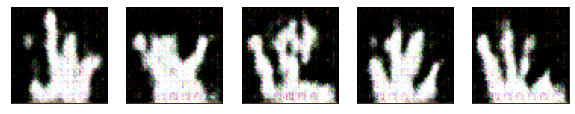

  0%|          | 0/32 [00:00<?, ?it/s]

[7/300]
Loss_D: 1.0182	Loss_G: 0.4191



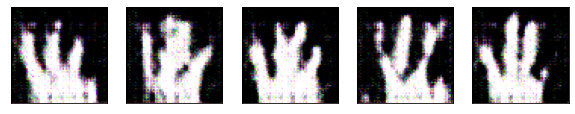

  0%|          | 0/32 [00:00<?, ?it/s]

[8/300]
Loss_D: 0.9701	Loss_G: 1.7264



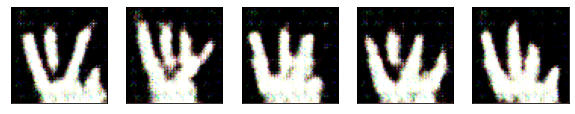

  0%|          | 0/32 [00:00<?, ?it/s]

[9/300]
Loss_D: 1.0940	Loss_G: 0.6263



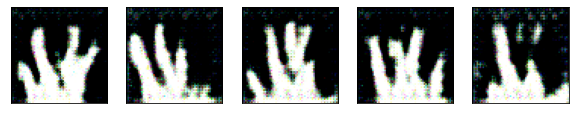

  0%|          | 0/32 [00:00<?, ?it/s]

[10/300]
Loss_D: 1.0947	Loss_G: 0.2386



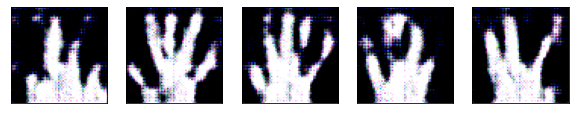

  0%|          | 0/32 [00:00<?, ?it/s]

[11/300]
Loss_D: 0.9531	Loss_G: 0.3018



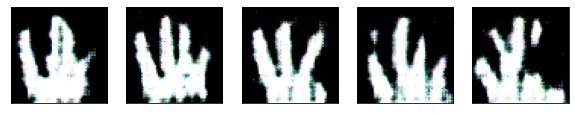

  0%|          | 0/32 [00:00<?, ?it/s]

[12/300]
Loss_D: 1.0711	Loss_G: 0.5446



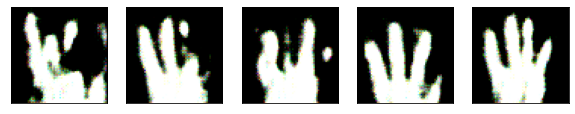

  0%|          | 0/32 [00:00<?, ?it/s]

[13/300]
Loss_D: 1.0078	Loss_G: 1.0344



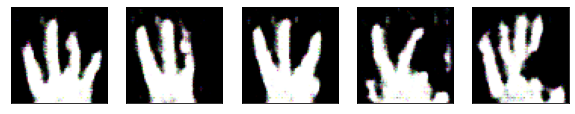

  0%|          | 0/32 [00:00<?, ?it/s]

[14/300]
Loss_D: 0.9866	Loss_G: 0.9345



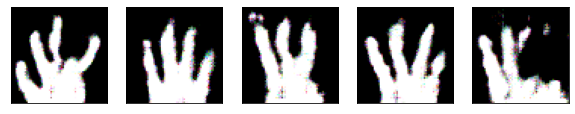

  0%|          | 0/32 [00:00<?, ?it/s]

[15/300]
Loss_D: 1.0332	Loss_G: 0.1266



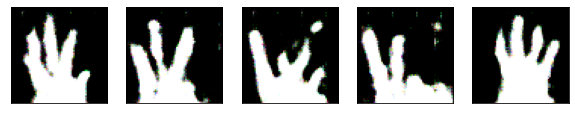

  0%|          | 0/32 [00:00<?, ?it/s]

[16/300]
Loss_D: 1.9259	Loss_G: 2.8584



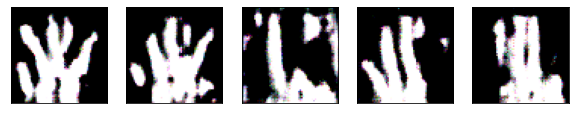

  0%|          | 0/32 [00:00<?, ?it/s]

[17/300]
Loss_D: 0.8876	Loss_G: 0.8794



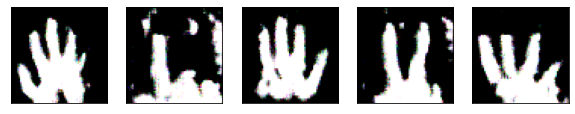

  0%|          | 0/32 [00:00<?, ?it/s]

[18/300]
Loss_D: 0.8986	Loss_G: 0.6880



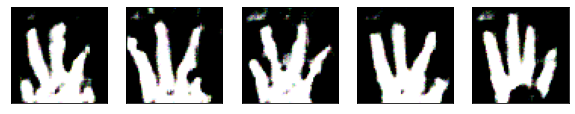

  0%|          | 0/32 [00:00<?, ?it/s]

[19/300]
Loss_D: 1.1022	Loss_G: -0.2771



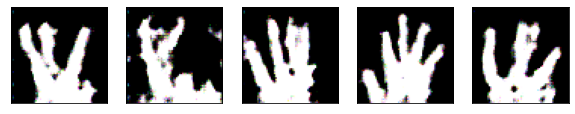

  0%|          | 0/32 [00:00<?, ?it/s]

[20/300]
Loss_D: 1.1000	Loss_G: 0.6947



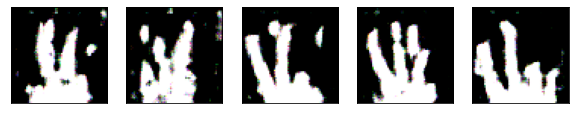

  0%|          | 0/32 [00:00<?, ?it/s]

[21/300]
Loss_D: 0.9454	Loss_G: 0.9752



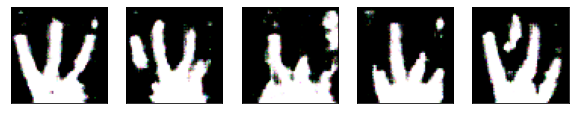

  0%|          | 0/32 [00:00<?, ?it/s]

[22/300]
Loss_D: 0.8611	Loss_G: 1.1385



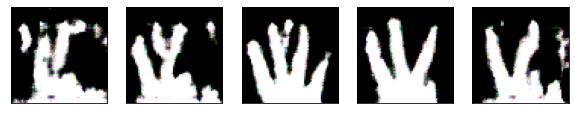

  0%|          | 0/32 [00:00<?, ?it/s]

[23/300]
Loss_D: 0.8810	Loss_G: 0.8661



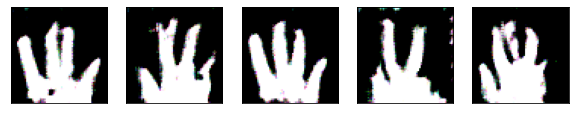

  0%|          | 0/32 [00:00<?, ?it/s]

[24/300]
Loss_D: 1.0779	Loss_G: 0.5477



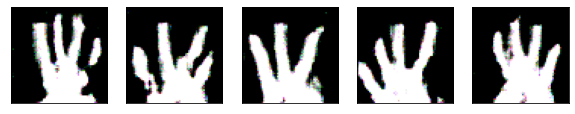

  0%|          | 0/32 [00:00<?, ?it/s]

[25/300]
Loss_D: 0.7859	Loss_G: 1.0356



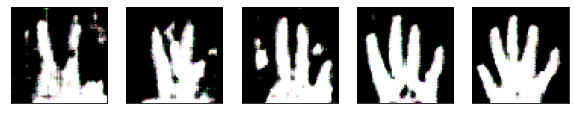

  0%|          | 0/32 [00:00<?, ?it/s]

[26/300]
Loss_D: 0.9101	Loss_G: 1.0714



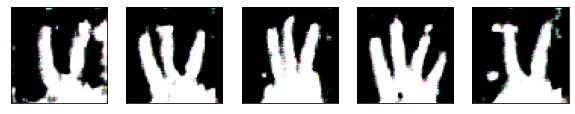

  0%|          | 0/32 [00:00<?, ?it/s]

[27/300]
Loss_D: 0.9506	Loss_G: 1.0393



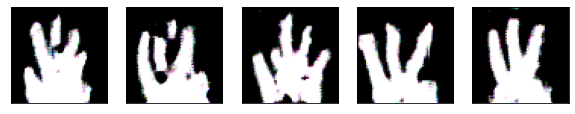

  0%|          | 0/32 [00:00<?, ?it/s]

[28/300]
Loss_D: 0.9520	Loss_G: 2.4455



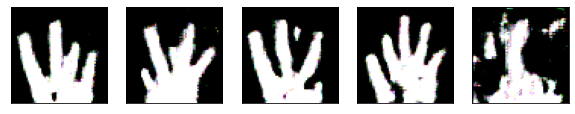

  0%|          | 0/32 [00:00<?, ?it/s]

[29/300]
Loss_D: 0.7819	Loss_G: 1.7068



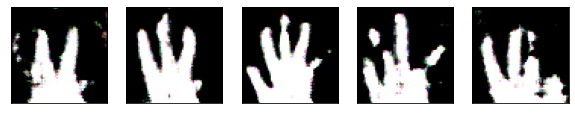

  0%|          | 0/32 [00:00<?, ?it/s]

[30/300]
Loss_D: 1.0791	Loss_G: 0.9475



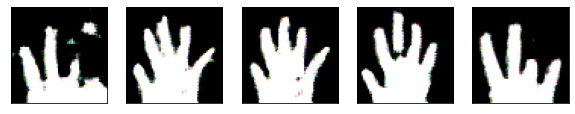

  0%|          | 0/32 [00:00<?, ?it/s]

[31/300]
Loss_D: 1.7503	Loss_G: 2.3077



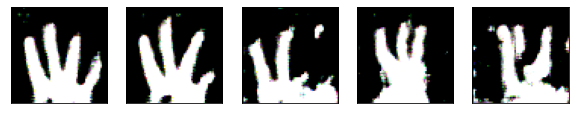

  0%|          | 0/32 [00:00<?, ?it/s]

[32/300]
Loss_D: 0.9222	Loss_G: 1.2834



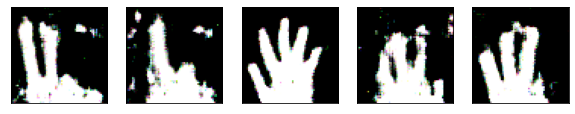

  0%|          | 0/32 [00:00<?, ?it/s]

[33/300]
Loss_D: 0.7917	Loss_G: 1.1430



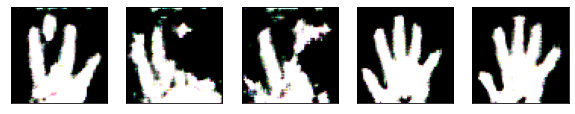

  0%|          | 0/32 [00:00<?, ?it/s]

[34/300]
Loss_D: 1.3983	Loss_G: 2.3863



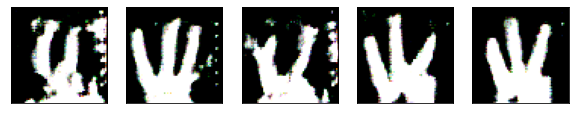

  0%|          | 0/32 [00:00<?, ?it/s]

[35/300]
Loss_D: 0.8820	Loss_G: 1.4522



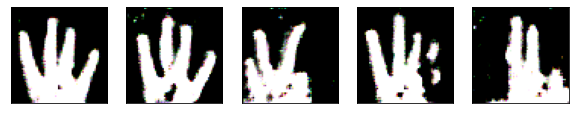

  0%|          | 0/32 [00:00<?, ?it/s]

[36/300]
Loss_D: 0.7621	Loss_G: 2.0535



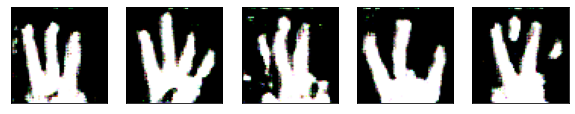

  0%|          | 0/32 [00:00<?, ?it/s]

[37/300]
Loss_D: 1.2268	Loss_G: 2.2782



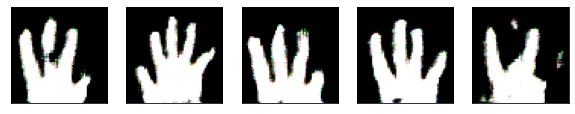

  0%|          | 0/32 [00:00<?, ?it/s]

[38/300]
Loss_D: 1.0504	Loss_G: 1.0441



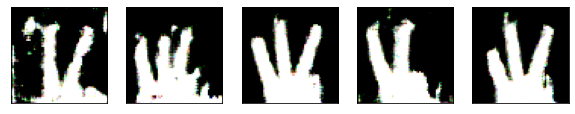

  0%|          | 0/32 [00:00<?, ?it/s]

[39/300]
Loss_D: 0.7880	Loss_G: 1.1256



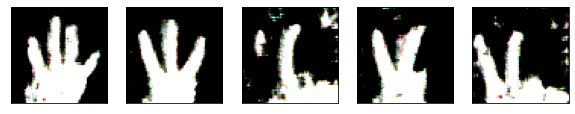

  0%|          | 0/32 [00:00<?, ?it/s]

[40/300]
Loss_D: 0.9131	Loss_G: 0.7959



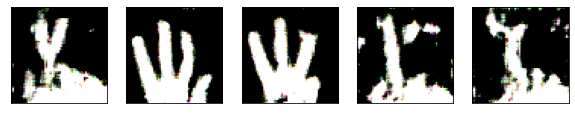

  0%|          | 0/32 [00:00<?, ?it/s]

[41/300]
Loss_D: 0.9125	Loss_G: 1.7762



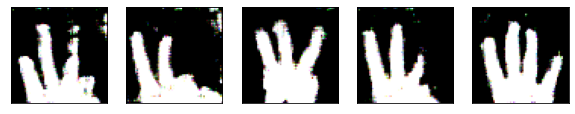

  0%|          | 0/32 [00:00<?, ?it/s]

[42/300]
Loss_D: 0.8108	Loss_G: 1.2249



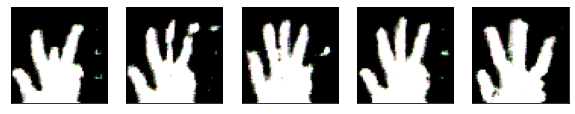

  0%|          | 0/32 [00:00<?, ?it/s]

[43/300]
Loss_D: 0.7860	Loss_G: 1.7629



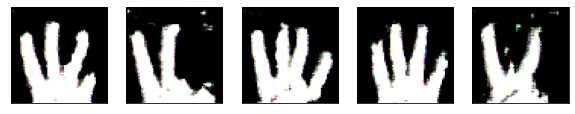

  0%|          | 0/32 [00:00<?, ?it/s]

[44/300]
Loss_D: 1.0512	Loss_G: 0.6135



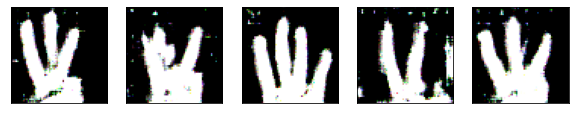

  0%|          | 0/32 [00:00<?, ?it/s]

[45/300]
Loss_D: 0.8018	Loss_G: 0.9643



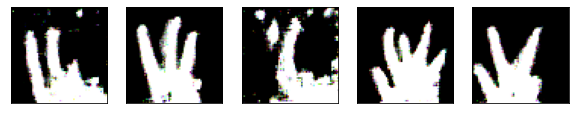

  0%|          | 0/32 [00:00<?, ?it/s]

[46/300]
Loss_D: 0.8667	Loss_G: 1.1531



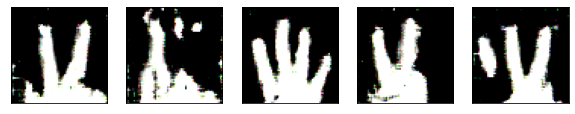

  0%|          | 0/32 [00:00<?, ?it/s]

[47/300]
Loss_D: 0.7640	Loss_G: 1.3934



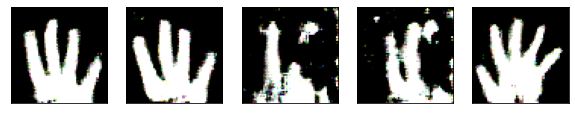

  0%|          | 0/32 [00:00<?, ?it/s]

[48/300]
Loss_D: 1.0218	Loss_G: 2.7148



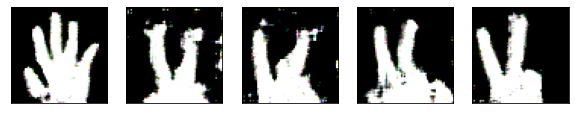

  0%|          | 0/32 [00:00<?, ?it/s]

[49/300]
Loss_D: 1.0794	Loss_G: 0.3049



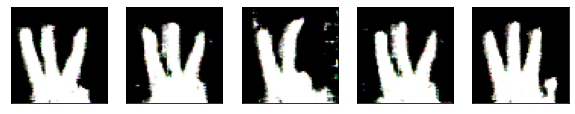

  0%|          | 0/32 [00:00<?, ?it/s]

[50/300]
Loss_D: 0.8876	Loss_G: 0.9882



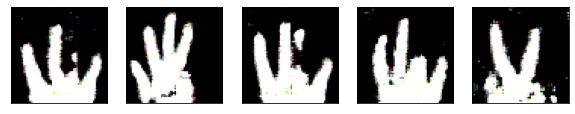

  0%|          | 0/32 [00:00<?, ?it/s]

[51/300]
Loss_D: 0.9282	Loss_G: 2.3542



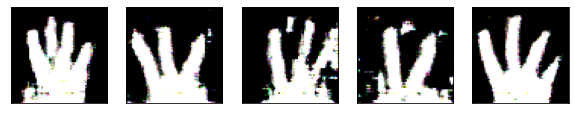

  0%|          | 0/32 [00:00<?, ?it/s]

[52/300]
Loss_D: 0.7663	Loss_G: 1.0956



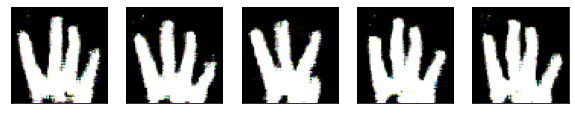

  0%|          | 0/32 [00:00<?, ?it/s]

[53/300]
Loss_D: 1.4408	Loss_G: 2.5914



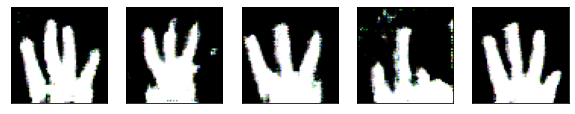

  0%|          | 0/32 [00:00<?, ?it/s]

[54/300]
Loss_D: 0.8082	Loss_G: 1.1251



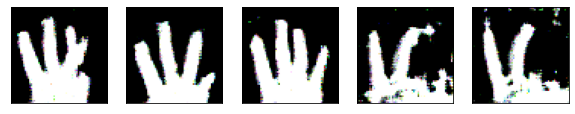

  0%|          | 0/32 [00:00<?, ?it/s]

[55/300]
Loss_D: 0.8490	Loss_G: 1.9120



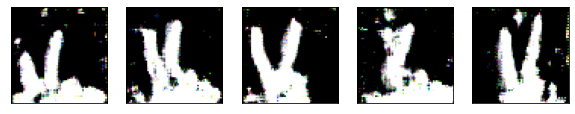

  0%|          | 0/32 [00:00<?, ?it/s]

[56/300]
Loss_D: 0.8508	Loss_G: 1.3270



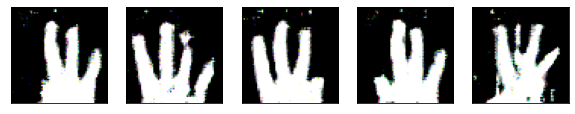

  0%|          | 0/32 [00:00<?, ?it/s]

[57/300]
Loss_D: 0.8905	Loss_G: 1.0062



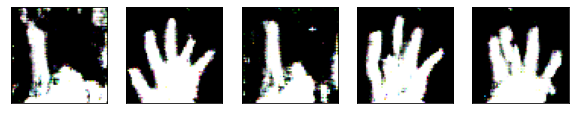

  0%|          | 0/32 [00:00<?, ?it/s]

[58/300]
Loss_D: 0.7992	Loss_G: 1.0225



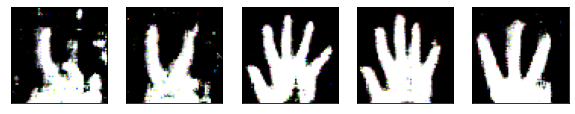

  0%|          | 0/32 [00:00<?, ?it/s]

[59/300]
Loss_D: 0.7728	Loss_G: 0.9961



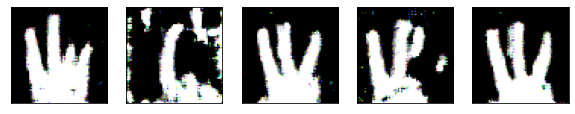

  0%|          | 0/32 [00:00<?, ?it/s]

[60/300]
Loss_D: 0.9689	Loss_G: 3.0656



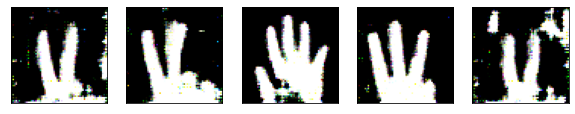

  0%|          | 0/32 [00:00<?, ?it/s]

[61/300]
Loss_D: 0.7271	Loss_G: 1.4298



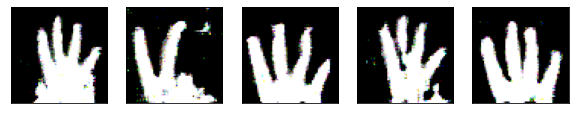

  0%|          | 0/32 [00:00<?, ?it/s]

[62/300]
Loss_D: 0.9208	Loss_G: 0.8770



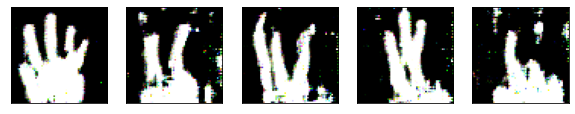

  0%|          | 0/32 [00:00<?, ?it/s]

[63/300]
Loss_D: 0.7150	Loss_G: 1.4011



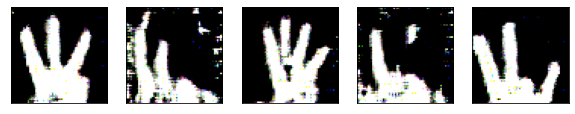

  0%|          | 0/32 [00:00<?, ?it/s]

[64/300]
Loss_D: 0.7454	Loss_G: 1.5799



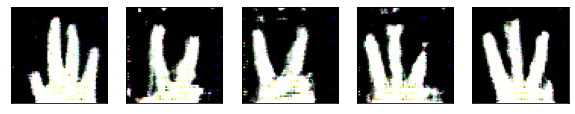

  0%|          | 0/32 [00:00<?, ?it/s]

[65/300]
Loss_D: 0.8395	Loss_G: 1.2264



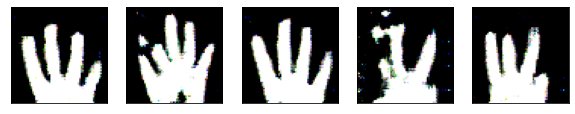

  0%|          | 0/32 [00:00<?, ?it/s]

[66/300]
Loss_D: 0.8343	Loss_G: 1.4220



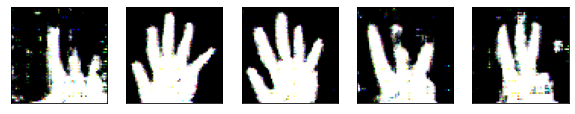

  0%|          | 0/32 [00:00<?, ?it/s]

[67/300]
Loss_D: 0.8986	Loss_G: 1.0287



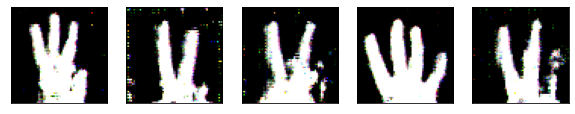

  0%|          | 0/32 [00:00<?, ?it/s]

[68/300]
Loss_D: 0.7391	Loss_G: 1.4173



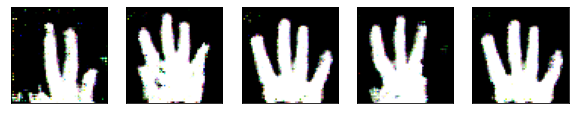

  0%|          | 0/32 [00:00<?, ?it/s]

[69/300]
Loss_D: 0.8889	Loss_G: 1.4910



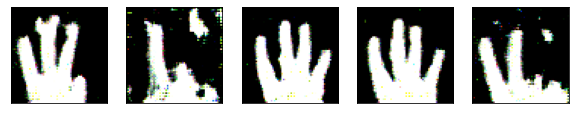

  0%|          | 0/32 [00:00<?, ?it/s]

[70/300]
Loss_D: 0.9425	Loss_G: 0.6630



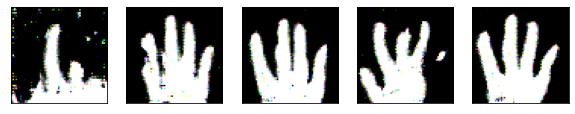

  0%|          | 0/32 [00:00<?, ?it/s]

[71/300]
Loss_D: 0.7644	Loss_G: 1.6313



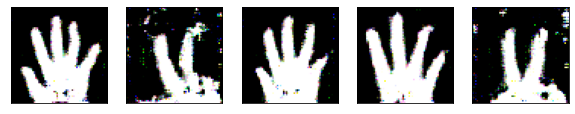

  0%|          | 0/32 [00:00<?, ?it/s]

[72/300]
Loss_D: 0.9090	Loss_G: 2.4480



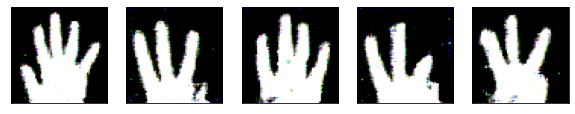

  0%|          | 0/32 [00:00<?, ?it/s]

[73/300]
Loss_D: 0.7960	Loss_G: 1.3129



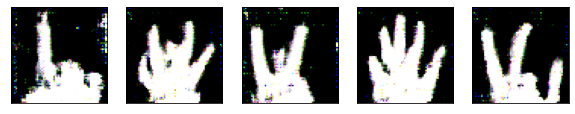

  0%|          | 0/32 [00:00<?, ?it/s]

[74/300]
Loss_D: 0.6531	Loss_G: 2.4125



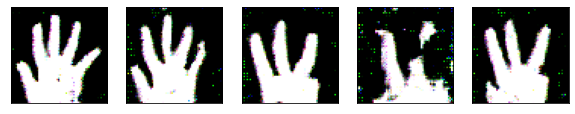

  0%|          | 0/32 [00:00<?, ?it/s]

[75/300]
Loss_D: 0.7336	Loss_G: 2.8086



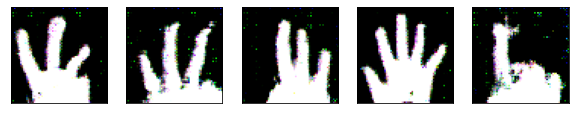

  0%|          | 0/32 [00:00<?, ?it/s]

[76/300]
Loss_D: 0.7611	Loss_G: 1.0825



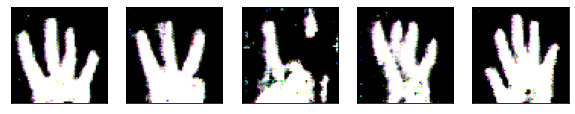

  0%|          | 0/32 [00:00<?, ?it/s]

[77/300]
Loss_D: 0.6723	Loss_G: 1.9066



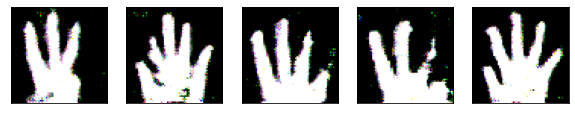

  0%|          | 0/32 [00:00<?, ?it/s]

[78/300]
Loss_D: 0.6873	Loss_G: 1.2627



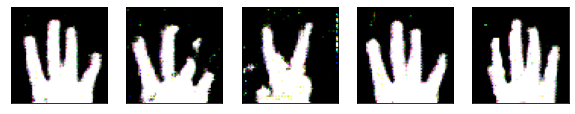

  0%|          | 0/32 [00:00<?, ?it/s]

[79/300]
Loss_D: 0.7471	Loss_G: 1.7384



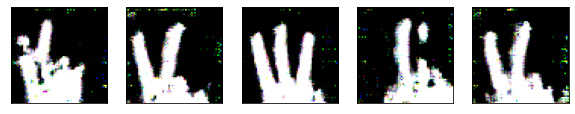

  0%|          | 0/32 [00:00<?, ?it/s]

[80/300]
Loss_D: 0.6564	Loss_G: 2.8996



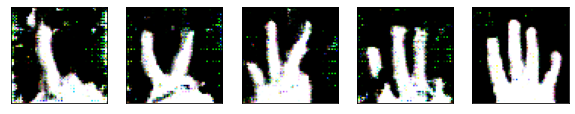

  0%|          | 0/32 [00:00<?, ?it/s]

[81/300]
Loss_D: 0.8477	Loss_G: 1.6863



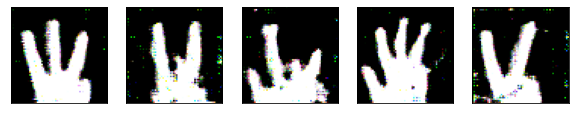

  0%|          | 0/32 [00:00<?, ?it/s]

[82/300]
Loss_D: 0.7920	Loss_G: 1.1253



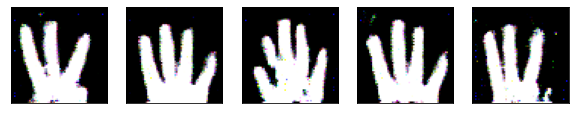

  0%|          | 0/32 [00:00<?, ?it/s]

[83/300]
Loss_D: 0.7061	Loss_G: 1.9628



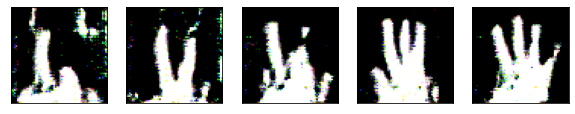

  0%|          | 0/32 [00:00<?, ?it/s]

[84/300]
Loss_D: 0.7562	Loss_G: 0.9951



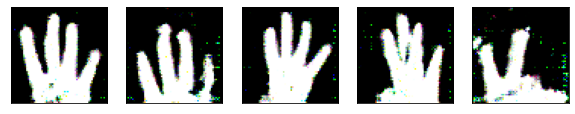

  0%|          | 0/32 [00:00<?, ?it/s]

[85/300]
Loss_D: 0.8660	Loss_G: 0.8606



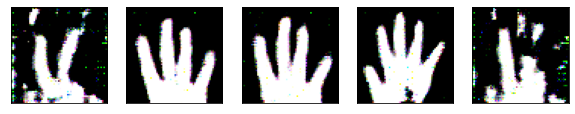

  0%|          | 0/32 [00:00<?, ?it/s]

[86/300]
Loss_D: 0.7361	Loss_G: 1.4606



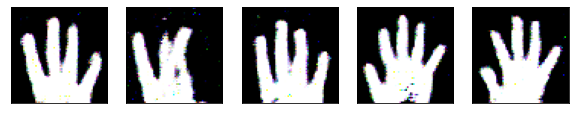

  0%|          | 0/32 [00:00<?, ?it/s]

[87/300]
Loss_D: 0.7665	Loss_G: 1.2970



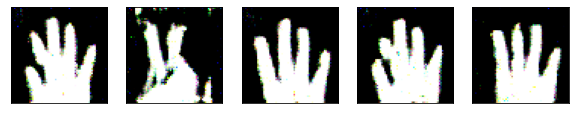

  0%|          | 0/32 [00:00<?, ?it/s]

[88/300]
Loss_D: 0.7803	Loss_G: 1.9085



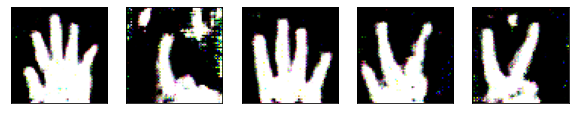

  0%|          | 0/32 [00:00<?, ?it/s]

[89/300]
Loss_D: 0.7753	Loss_G: 1.1031



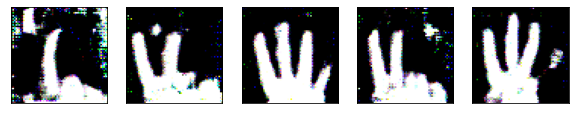

  0%|          | 0/32 [00:00<?, ?it/s]

[90/300]
Loss_D: 0.9592	Loss_G: 0.8385



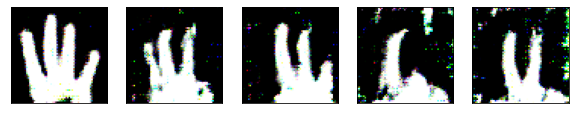

  0%|          | 0/32 [00:00<?, ?it/s]

[91/300]
Loss_D: 0.8547	Loss_G: 1.4084



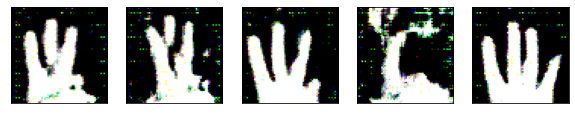

  0%|          | 0/32 [00:00<?, ?it/s]

[92/300]
Loss_D: 0.7382	Loss_G: 1.7547



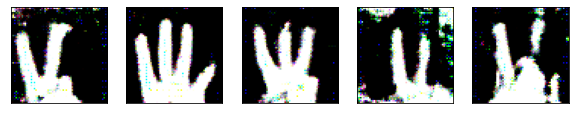

  0%|          | 0/32 [00:00<?, ?it/s]

[93/300]
Loss_D: 0.7384	Loss_G: 1.8695



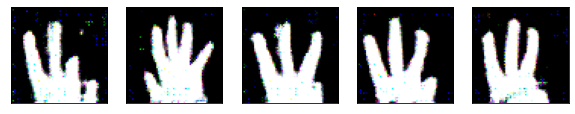

  0%|          | 0/32 [00:00<?, ?it/s]

[94/300]
Loss_D: 0.9424	Loss_G: 1.4774



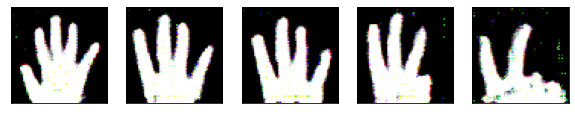

  0%|          | 0/32 [00:00<?, ?it/s]

[95/300]
Loss_D: 0.7372	Loss_G: 2.1793



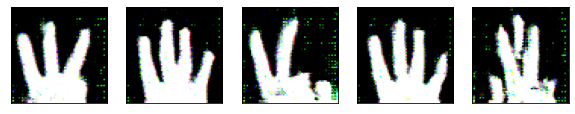

  0%|          | 0/32 [00:00<?, ?it/s]

[96/300]
Loss_D: 0.7597	Loss_G: 1.3725



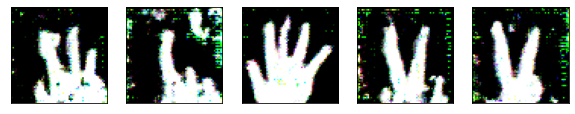

  0%|          | 0/32 [00:00<?, ?it/s]

[97/300]
Loss_D: 0.9011	Loss_G: 0.9484



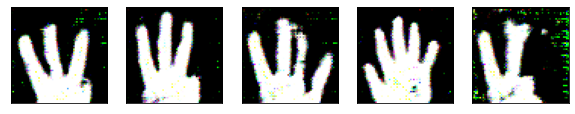

  0%|          | 0/32 [00:00<?, ?it/s]

[98/300]
Loss_D: 0.7040	Loss_G: 1.8565



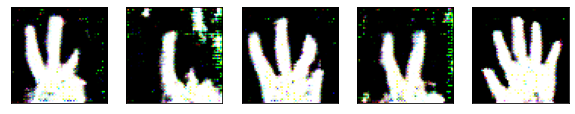

  0%|          | 0/32 [00:00<?, ?it/s]

[99/300]
Loss_D: 0.6837	Loss_G: 2.3467



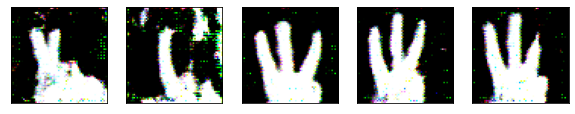

  0%|          | 0/32 [00:00<?, ?it/s]

[100/300]
Loss_D: 0.7582	Loss_G: 1.1595



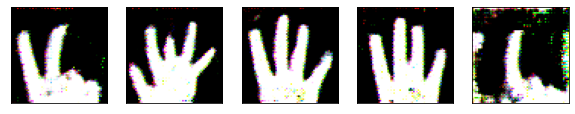

  0%|          | 0/32 [00:00<?, ?it/s]

[101/300]
Loss_D: 0.9294	Loss_G: 0.8444



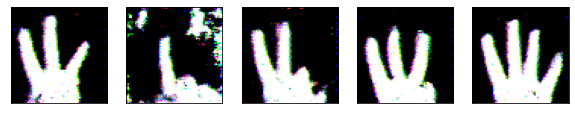

  0%|          | 0/32 [00:00<?, ?it/s]

[102/300]
Loss_D: 0.7681	Loss_G: 1.9831



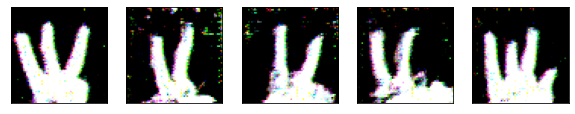

  0%|          | 0/32 [00:00<?, ?it/s]

[103/300]
Loss_D: 0.7912	Loss_G: 1.2809



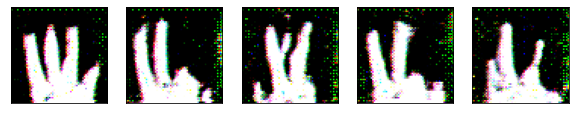

  0%|          | 0/32 [00:00<?, ?it/s]

[104/300]
Loss_D: 0.7726	Loss_G: 2.2518



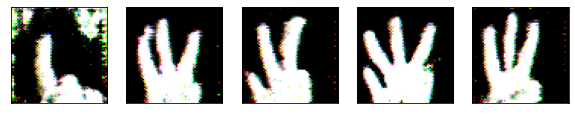

  0%|          | 0/32 [00:00<?, ?it/s]

[105/300]
Loss_D: 0.7107	Loss_G: 2.0818



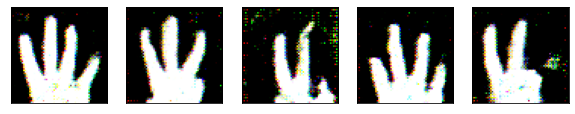

  0%|          | 0/32 [00:00<?, ?it/s]

[106/300]
Loss_D: 0.7881	Loss_G: 1.4879



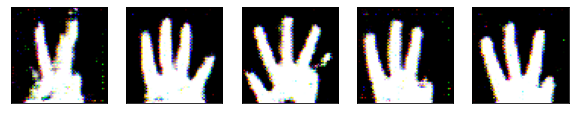

  0%|          | 0/32 [00:00<?, ?it/s]

[107/300]
Loss_D: 0.6774	Loss_G: 1.8367



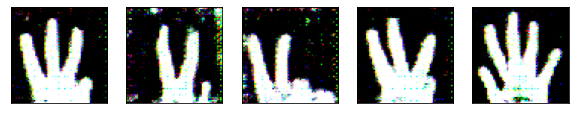

  0%|          | 0/32 [00:00<?, ?it/s]

[108/300]
Loss_D: 0.9139	Loss_G: 1.5913



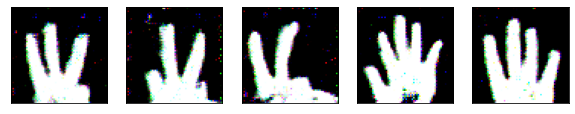

  0%|          | 0/32 [00:00<?, ?it/s]

[109/300]
Loss_D: 0.6477	Loss_G: 2.5562



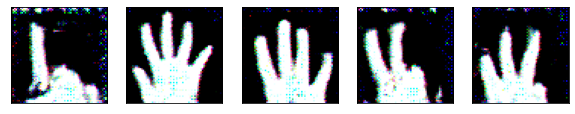

  0%|          | 0/32 [00:00<?, ?it/s]

[110/300]
Loss_D: 0.8797	Loss_G: 1.9845



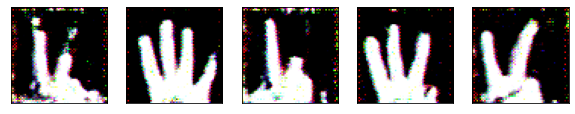

  0%|          | 0/32 [00:00<?, ?it/s]

[111/300]
Loss_D: 0.7437	Loss_G: 1.9262



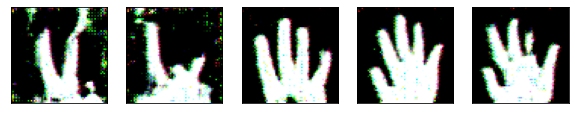

  0%|          | 0/32 [00:00<?, ?it/s]

[112/300]
Loss_D: 0.6872	Loss_G: 1.7476



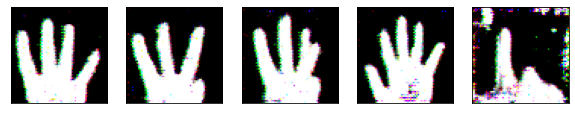

  0%|          | 0/32 [00:00<?, ?it/s]

[113/300]
Loss_D: 0.6313	Loss_G: 2.9523



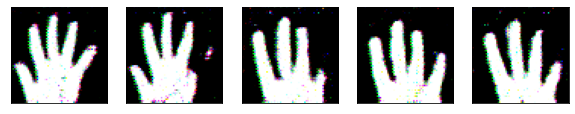

  0%|          | 0/32 [00:00<?, ?it/s]

[114/300]
Loss_D: 0.7688	Loss_G: 1.3246



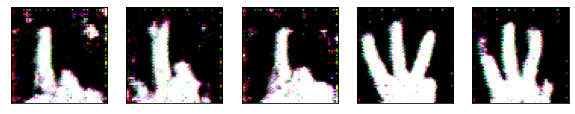

  0%|          | 0/32 [00:00<?, ?it/s]

[115/300]
Loss_D: 0.6907	Loss_G: 1.8305



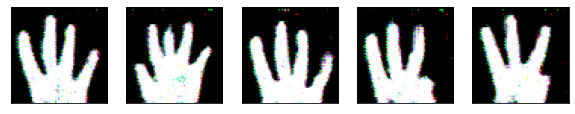

  0%|          | 0/32 [00:00<?, ?it/s]

[116/300]
Loss_D: 1.3261	Loss_G: 0.9070



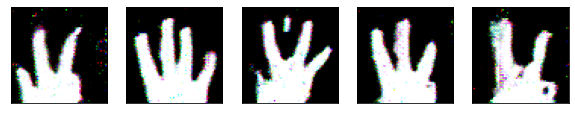

  0%|          | 0/32 [00:00<?, ?it/s]

[117/300]
Loss_D: 0.8092	Loss_G: 1.1963



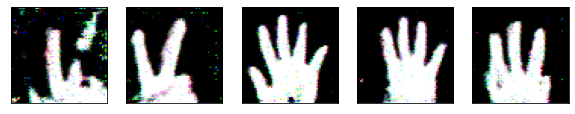

  0%|          | 0/32 [00:00<?, ?it/s]

[118/300]
Loss_D: 0.7265	Loss_G: 3.4205



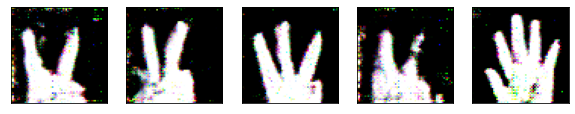

  0%|          | 0/32 [00:00<?, ?it/s]

[119/300]
Loss_D: 0.8324	Loss_G: 0.7788



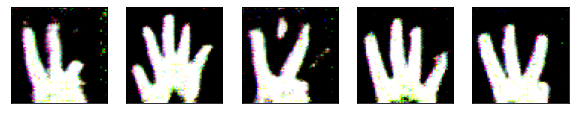

  0%|          | 0/32 [00:00<?, ?it/s]

[120/300]
Loss_D: 0.8371	Loss_G: 0.9657



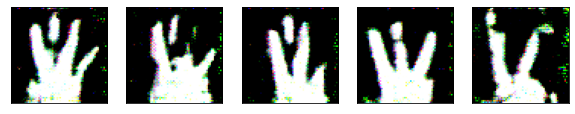

  0%|          | 0/32 [00:00<?, ?it/s]

[121/300]
Loss_D: 0.9250	Loss_G: 0.9328



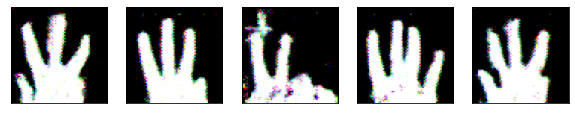

  0%|          | 0/32 [00:00<?, ?it/s]

[122/300]
Loss_D: 1.0812	Loss_G: 0.8115



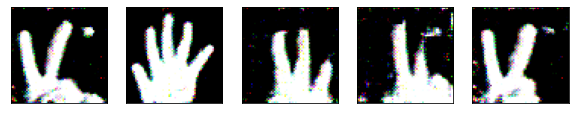

  0%|          | 0/32 [00:00<?, ?it/s]

[123/300]
Loss_D: 0.7199	Loss_G: 1.5698



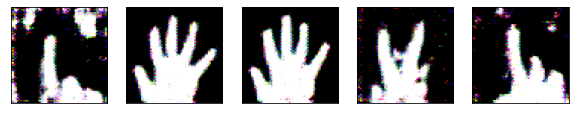

  0%|          | 0/32 [00:00<?, ?it/s]

[124/300]
Loss_D: 0.6603	Loss_G: 1.8460



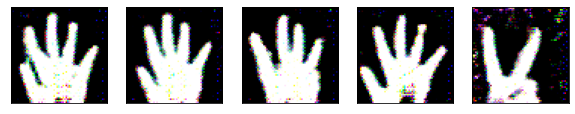

  0%|          | 0/32 [00:00<?, ?it/s]

[125/300]
Loss_D: 0.7916	Loss_G: 1.5653



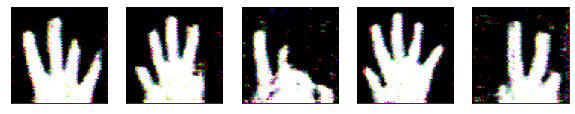

  0%|          | 0/32 [00:00<?, ?it/s]

[126/300]
Loss_D: 1.2852	Loss_G: 0.4288



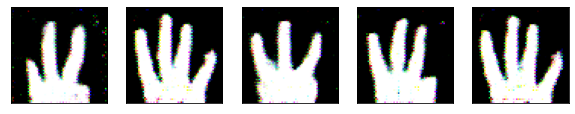

  0%|          | 0/32 [00:00<?, ?it/s]

[127/300]
Loss_D: 0.6774	Loss_G: 2.5239



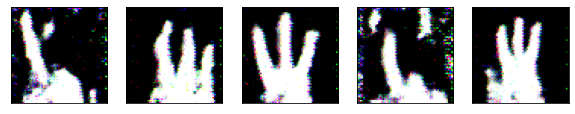

  0%|          | 0/32 [00:00<?, ?it/s]

[128/300]
Loss_D: 0.6406	Loss_G: 2.6929



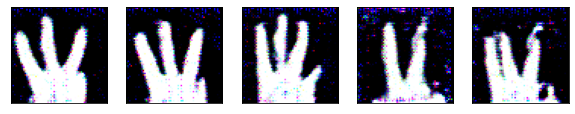

  0%|          | 0/32 [00:00<?, ?it/s]

[129/300]
Loss_D: 0.6986	Loss_G: 2.9412



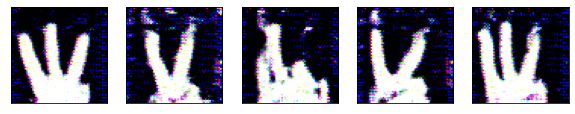

  0%|          | 0/32 [00:00<?, ?it/s]

[130/300]
Loss_D: 0.7459	Loss_G: 1.7136



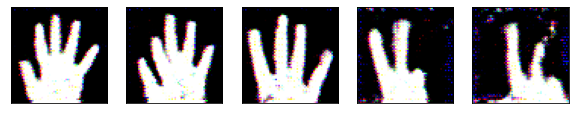

  0%|          | 0/32 [00:00<?, ?it/s]

[131/300]
Loss_D: 0.6570	Loss_G: 2.8491



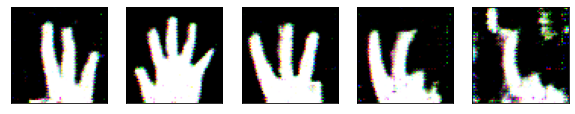

  0%|          | 0/32 [00:00<?, ?it/s]

[132/300]
Loss_D: 0.6802	Loss_G: 2.5327



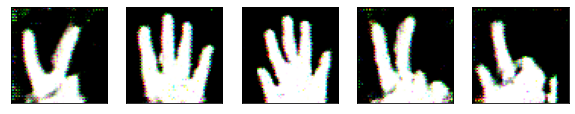

  0%|          | 0/32 [00:00<?, ?it/s]

[133/300]
Loss_D: 0.8732	Loss_G: 1.2495



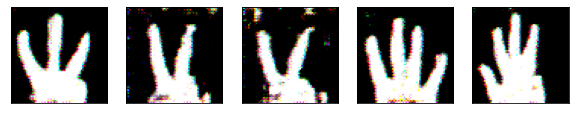

  0%|          | 0/32 [00:00<?, ?it/s]

[134/300]
Loss_D: 0.6533	Loss_G: 1.9952



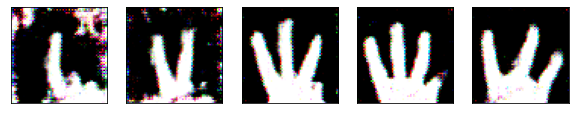

  0%|          | 0/32 [00:00<?, ?it/s]

[135/300]
Loss_D: 0.7178	Loss_G: 2.0389



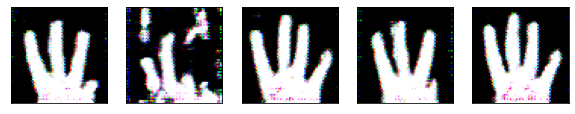

  0%|          | 0/32 [00:00<?, ?it/s]

[136/300]
Loss_D: 0.6689	Loss_G: 2.0345



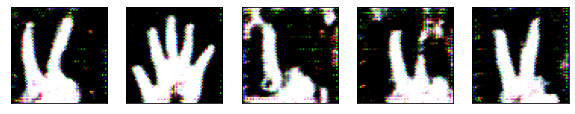

  0%|          | 0/32 [00:00<?, ?it/s]

[137/300]
Loss_D: 0.8839	Loss_G: 1.1239



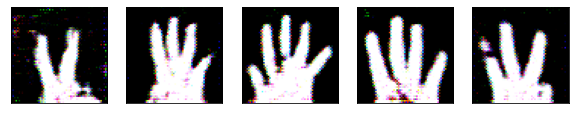

  0%|          | 0/32 [00:00<?, ?it/s]

[138/300]
Loss_D: 0.6696	Loss_G: 1.9351



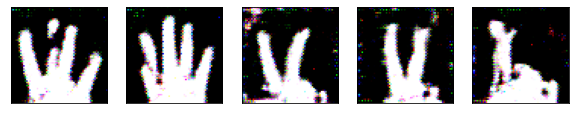

  0%|          | 0/32 [00:00<?, ?it/s]

[139/300]
Loss_D: 0.8262	Loss_G: 1.4871



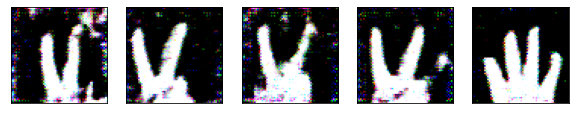

  0%|          | 0/32 [00:00<?, ?it/s]

[140/300]
Loss_D: 0.7573	Loss_G: 1.8088



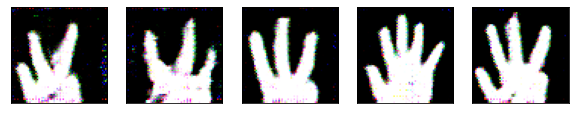

  0%|          | 0/32 [00:00<?, ?it/s]

[141/300]
Loss_D: 0.6954	Loss_G: 1.9489



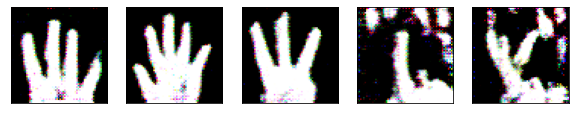

  0%|          | 0/32 [00:00<?, ?it/s]

[142/300]
Loss_D: 0.9576	Loss_G: 1.7480



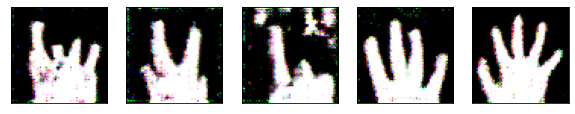

  0%|          | 0/32 [00:00<?, ?it/s]

[143/300]
Loss_D: 0.7063	Loss_G: 1.9078



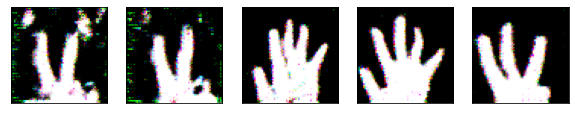

  0%|          | 0/32 [00:00<?, ?it/s]

[144/300]
Loss_D: 0.6866	Loss_G: 1.8541



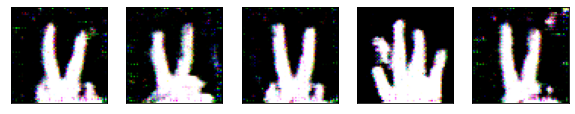

  0%|          | 0/32 [00:00<?, ?it/s]

[145/300]
Loss_D: 0.6961	Loss_G: 2.6579



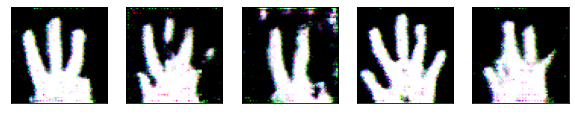

  0%|          | 0/32 [00:00<?, ?it/s]

[146/300]
Loss_D: 0.6241	Loss_G: 3.3029



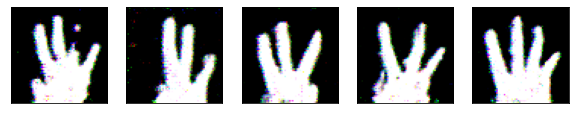

  0%|          | 0/32 [00:00<?, ?it/s]

[147/300]
Loss_D: 0.8360	Loss_G: 1.2974



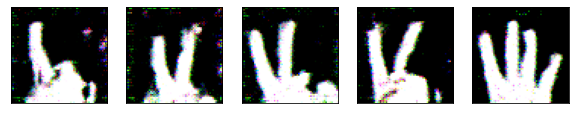

  0%|          | 0/32 [00:00<?, ?it/s]

[148/300]
Loss_D: 1.7820	Loss_G: -0.1799



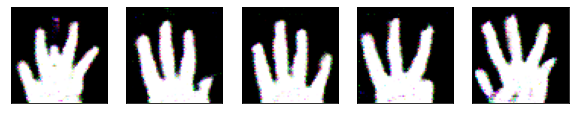

  0%|          | 0/32 [00:00<?, ?it/s]

[149/300]
Loss_D: 0.8725	Loss_G: 1.6938



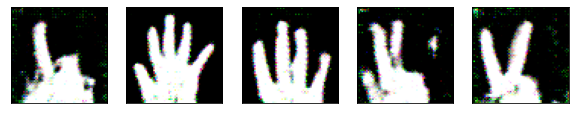

  0%|          | 0/32 [00:00<?, ?it/s]

[150/300]
Loss_D: 0.6578	Loss_G: 2.4342



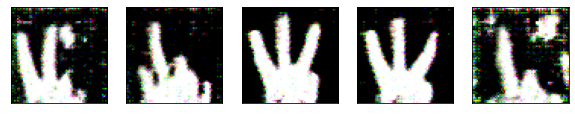

  0%|          | 0/32 [00:00<?, ?it/s]

[151/300]
Loss_D: 0.6726	Loss_G: 3.3467



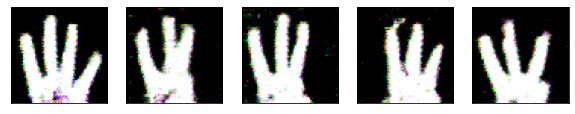

  0%|          | 0/32 [00:00<?, ?it/s]

[152/300]
Loss_D: 0.6309	Loss_G: 3.0395



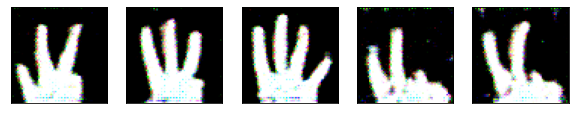

  0%|          | 0/32 [00:00<?, ?it/s]

[153/300]
Loss_D: 1.3618	Loss_G: 4.4388



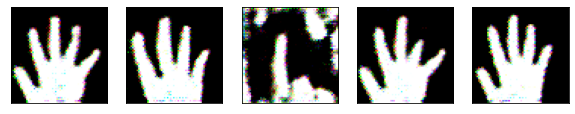

  0%|          | 0/32 [00:00<?, ?it/s]

[154/300]
Loss_D: 0.8085	Loss_G: 2.4324



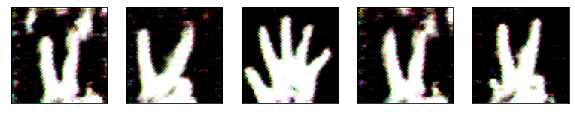

  0%|          | 0/32 [00:00<?, ?it/s]

[155/300]
Loss_D: 0.6836	Loss_G: 2.0351



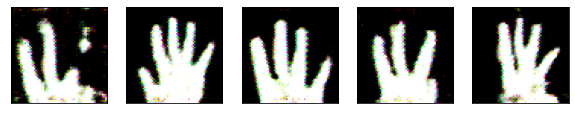

  0%|          | 0/32 [00:00<?, ?it/s]

[156/300]
Loss_D: 0.8752	Loss_G: 1.1409



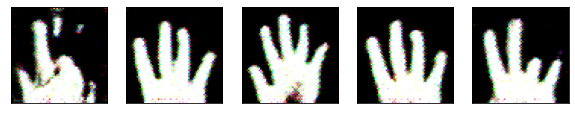

  0%|          | 0/32 [00:00<?, ?it/s]

[157/300]
Loss_D: 0.6683	Loss_G: 2.2306



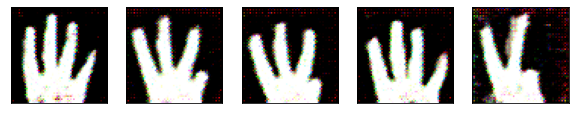

  0%|          | 0/32 [00:00<?, ?it/s]

[158/300]
Loss_D: 0.6551	Loss_G: 4.0625



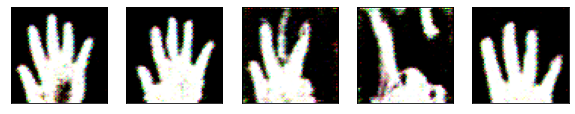

  0%|          | 0/32 [00:00<?, ?it/s]

[159/300]
Loss_D: 0.6382	Loss_G: 2.8075



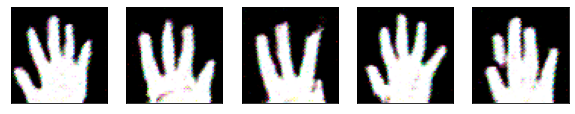

  0%|          | 0/32 [00:00<?, ?it/s]

[160/300]
Loss_D: 0.7483	Loss_G: 2.3213



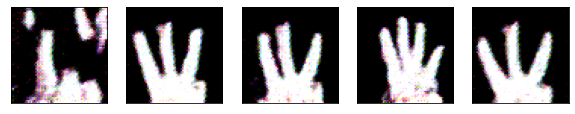

  0%|          | 0/32 [00:00<?, ?it/s]

[161/300]
Loss_D: 0.6414	Loss_G: 2.4007



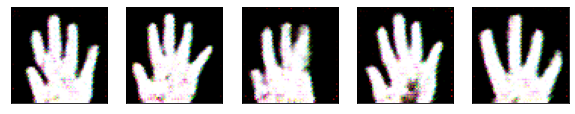

  0%|          | 0/32 [00:00<?, ?it/s]

[162/300]
Loss_D: 0.7095	Loss_G: 1.8925



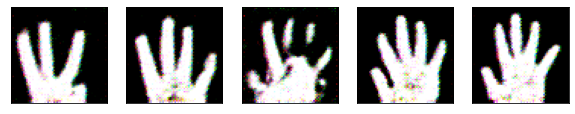

  0%|          | 0/32 [00:00<?, ?it/s]

[163/300]
Loss_D: 0.8167	Loss_G: 0.8140



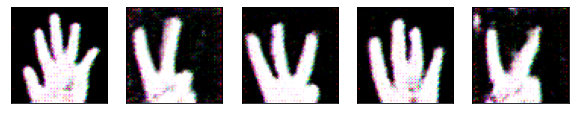

  0%|          | 0/32 [00:00<?, ?it/s]

[164/300]
Loss_D: 0.7391	Loss_G: 1.4840



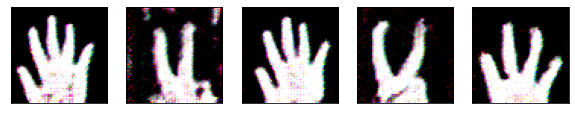

  0%|          | 0/32 [00:00<?, ?it/s]

[165/300]
Loss_D: 1.0189	Loss_G: 2.3418



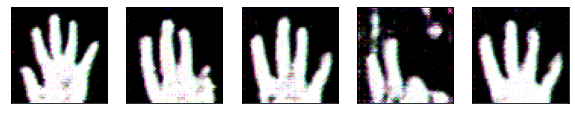

  0%|          | 0/32 [00:00<?, ?it/s]

[166/300]
Loss_D: 0.7914	Loss_G: 1.5662



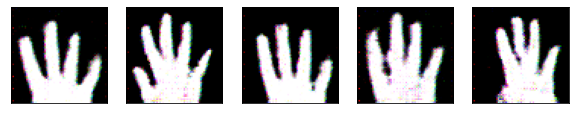

  0%|          | 0/32 [00:00<?, ?it/s]

[167/300]
Loss_D: 0.8049	Loss_G: 1.7890



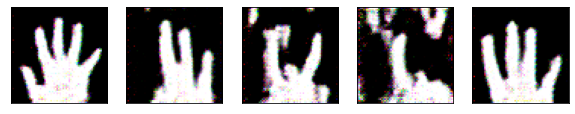

  0%|          | 0/32 [00:00<?, ?it/s]

[168/300]
Loss_D: 0.7401	Loss_G: 2.4321



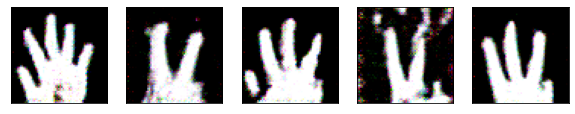

  0%|          | 0/32 [00:00<?, ?it/s]

[169/300]
Loss_D: 0.7850	Loss_G: 1.2523



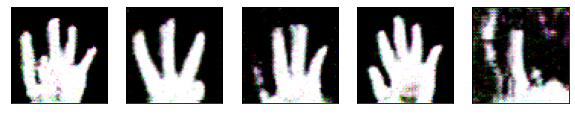

  0%|          | 0/32 [00:00<?, ?it/s]

[170/300]
Loss_D: 0.7684	Loss_G: 1.4579



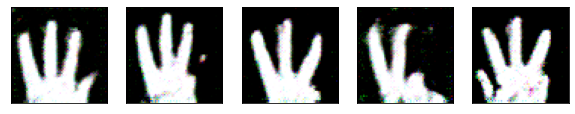

  0%|          | 0/32 [00:00<?, ?it/s]

[171/300]
Loss_D: 0.7089	Loss_G: 2.0963



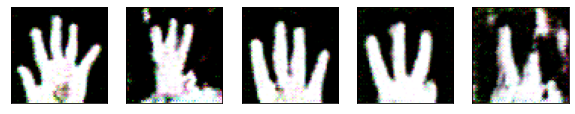

  0%|          | 0/32 [00:00<?, ?it/s]

[172/300]
Loss_D: 0.6837	Loss_G: 1.8316



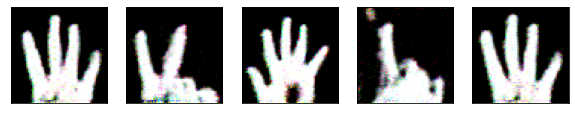

  0%|          | 0/32 [00:00<?, ?it/s]

[173/300]
Loss_D: 0.7028	Loss_G: 1.4715



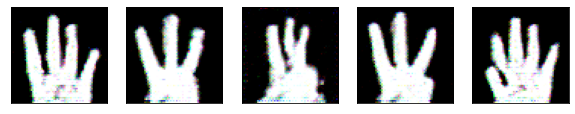

  0%|          | 0/32 [00:00<?, ?it/s]

[174/300]
Loss_D: 0.7053	Loss_G: 2.1672



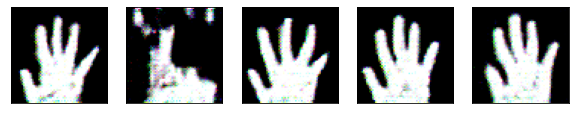

  0%|          | 0/32 [00:00<?, ?it/s]

[175/300]
Loss_D: 0.6810	Loss_G: 2.0100



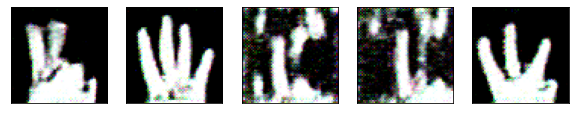

  0%|          | 0/32 [00:00<?, ?it/s]

[176/300]
Loss_D: 0.6805	Loss_G: 1.8126



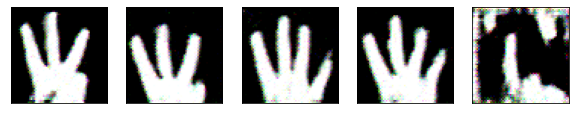

  0%|          | 0/32 [00:00<?, ?it/s]

[177/300]
Loss_D: 0.6704	Loss_G: 2.8853



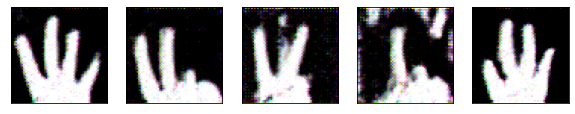

  0%|          | 0/32 [00:00<?, ?it/s]

[178/300]
Loss_D: 0.7806	Loss_G: 1.3323



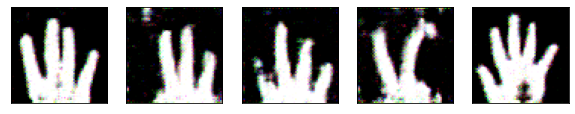

  0%|          | 0/32 [00:00<?, ?it/s]

[179/300]
Loss_D: 0.7197	Loss_G: 2.7945



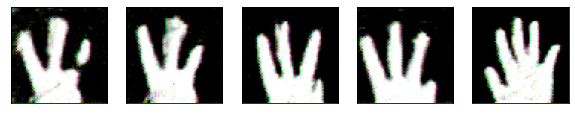

  0%|          | 0/32 [00:00<?, ?it/s]

[180/300]
Loss_D: 0.6613	Loss_G: 2.2787



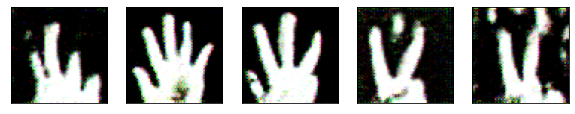

  0%|          | 0/32 [00:00<?, ?it/s]

[181/300]
Loss_D: 0.7368	Loss_G: 1.7824



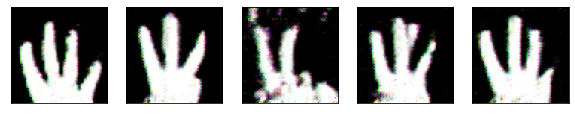

  0%|          | 0/32 [00:00<?, ?it/s]

[182/300]
Loss_D: 0.6756	Loss_G: 1.8227



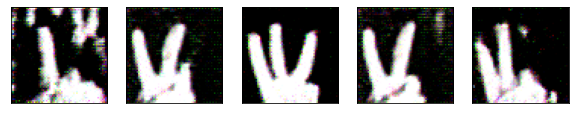

  0%|          | 0/32 [00:00<?, ?it/s]

[183/300]
Loss_D: 0.6463	Loss_G: 3.5676



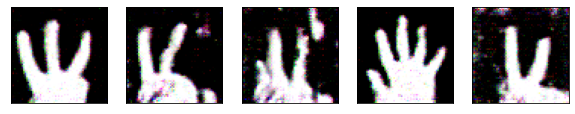

  0%|          | 0/32 [00:00<?, ?it/s]

[184/300]
Loss_D: 0.7378	Loss_G: 2.2255



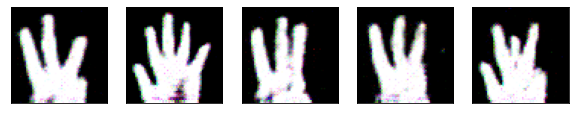

  0%|          | 0/32 [00:00<?, ?it/s]

[185/300]
Loss_D: 0.7654	Loss_G: 2.0540



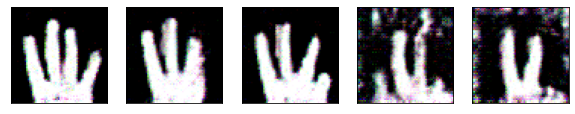

  0%|          | 0/32 [00:00<?, ?it/s]

[186/300]
Loss_D: 0.7223	Loss_G: 1.8404



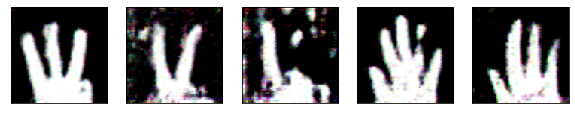

  0%|          | 0/32 [00:00<?, ?it/s]

[187/300]
Loss_D: 0.9056	Loss_G: 0.9069



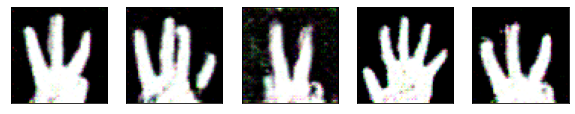

  0%|          | 0/32 [00:00<?, ?it/s]

[188/300]
Loss_D: 0.7969	Loss_G: 1.4892



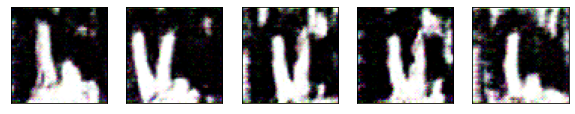

  0%|          | 0/32 [00:00<?, ?it/s]

[189/300]
Loss_D: 0.7077	Loss_G: 2.0994



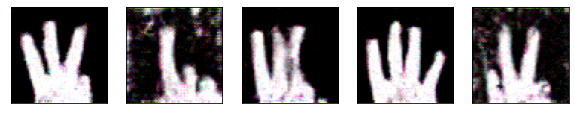

  0%|          | 0/32 [00:00<?, ?it/s]

[190/300]
Loss_D: 0.6732	Loss_G: 1.7835



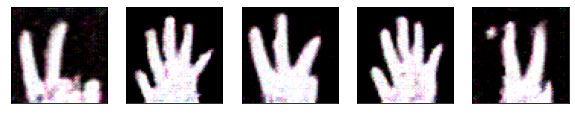

  0%|          | 0/32 [00:00<?, ?it/s]

[191/300]
Loss_D: 0.6605	Loss_G: 2.3749



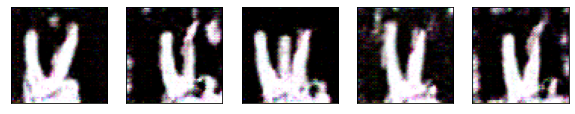

  0%|          | 0/32 [00:00<?, ?it/s]

[192/300]
Loss_D: 0.7104	Loss_G: 2.1255



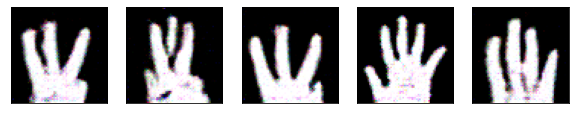

  0%|          | 0/32 [00:00<?, ?it/s]

[193/300]
Loss_D: 0.8713	Loss_G: 2.2058



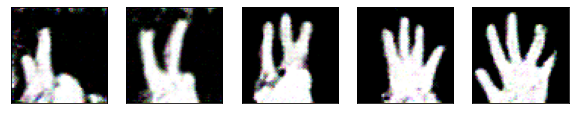

  0%|          | 0/32 [00:00<?, ?it/s]

[194/300]
Loss_D: 0.6905	Loss_G: 2.0569



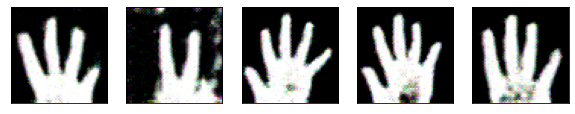

  0%|          | 0/32 [00:00<?, ?it/s]

[195/300]
Loss_D: 0.7048	Loss_G: 1.9505



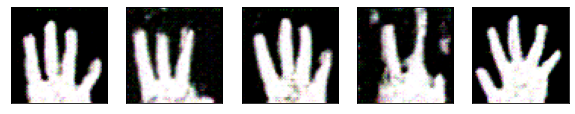

  0%|          | 0/32 [00:00<?, ?it/s]

[196/300]
Loss_D: 0.6824	Loss_G: 2.3383



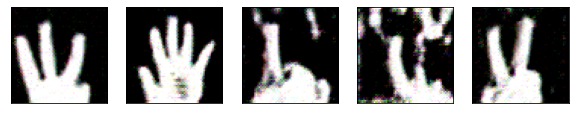

  0%|          | 0/32 [00:00<?, ?it/s]

[197/300]
Loss_D: 0.6389	Loss_G: 2.3205



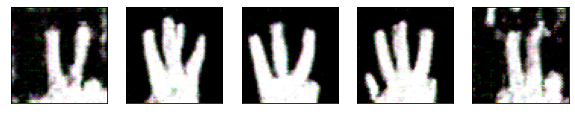

  0%|          | 0/32 [00:00<?, ?it/s]

[198/300]
Loss_D: 0.8232	Loss_G: 1.9035



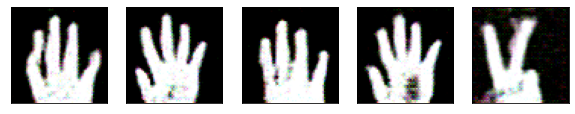

  0%|          | 0/32 [00:00<?, ?it/s]

[199/300]
Loss_D: 0.7656	Loss_G: 1.3810



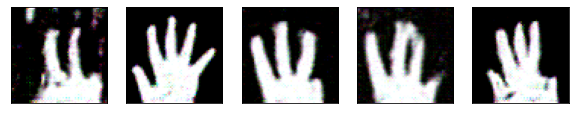

  0%|          | 0/32 [00:00<?, ?it/s]

[200/300]
Loss_D: 0.9141	Loss_G: 1.8552



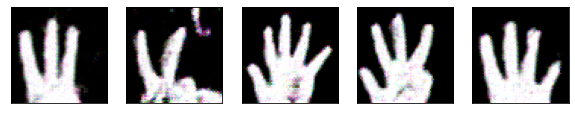

  0%|          | 0/32 [00:00<?, ?it/s]

[201/300]
Loss_D: 0.7813	Loss_G: 1.8255



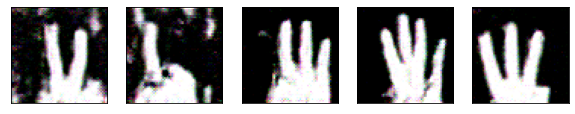

  0%|          | 0/32 [00:00<?, ?it/s]

[202/300]
Loss_D: 0.6716	Loss_G: 2.5426



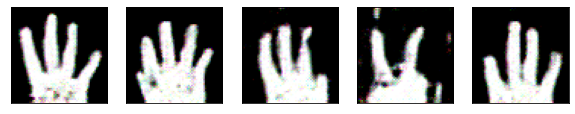

  0%|          | 0/32 [00:00<?, ?it/s]

[203/300]
Loss_D: 0.7277	Loss_G: 1.4094



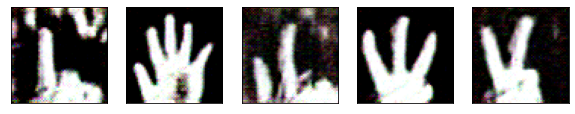

  0%|          | 0/32 [00:00<?, ?it/s]

[204/300]
Loss_D: 0.6863	Loss_G: 1.8810



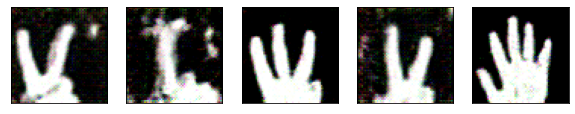

  0%|          | 0/32 [00:00<?, ?it/s]

[205/300]
Loss_D: 0.7922	Loss_G: 2.3777



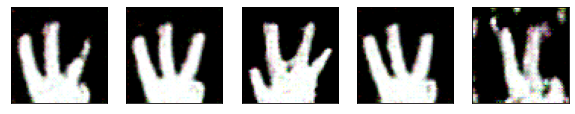

  0%|          | 0/32 [00:00<?, ?it/s]

[206/300]
Loss_D: 0.7402	Loss_G: 1.9216



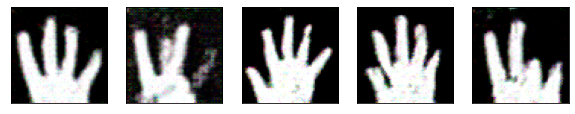

  0%|          | 0/32 [00:00<?, ?it/s]

[207/300]
Loss_D: 0.6660	Loss_G: 1.8813



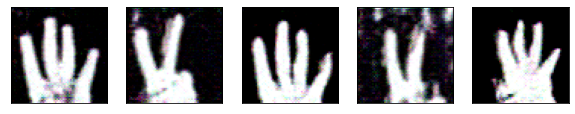

  0%|          | 0/32 [00:00<?, ?it/s]

[208/300]
Loss_D: 0.6867	Loss_G: 1.9446



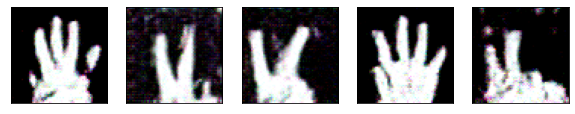

  0%|          | 0/32 [00:00<?, ?it/s]

[209/300]
Loss_D: 0.6622	Loss_G: 2.3593



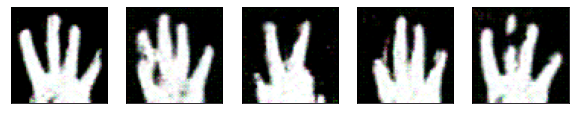

  0%|          | 0/32 [00:00<?, ?it/s]

[210/300]
Loss_D: 0.6385	Loss_G: 2.2887



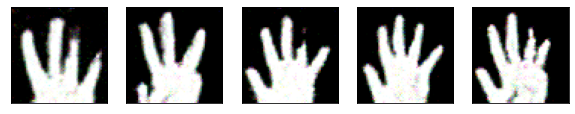

  0%|          | 0/32 [00:00<?, ?it/s]

[211/300]
Loss_D: 0.6382	Loss_G: 2.6305



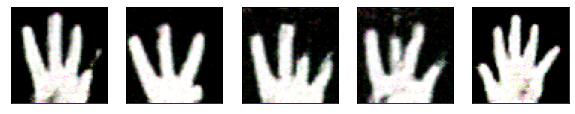

  0%|          | 0/32 [00:00<?, ?it/s]

[212/300]
Loss_D: 0.7316	Loss_G: 1.8687



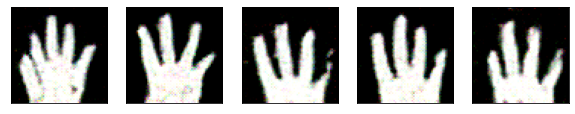

  0%|          | 0/32 [00:00<?, ?it/s]

[213/300]
Loss_D: 0.6824	Loss_G: 2.7134



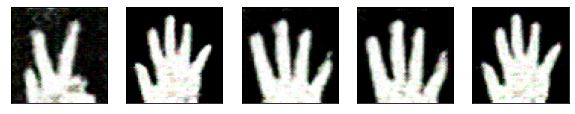

  0%|          | 0/32 [00:00<?, ?it/s]

[214/300]
Loss_D: 0.6781	Loss_G: 2.3636



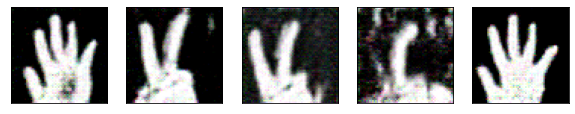

  0%|          | 0/32 [00:00<?, ?it/s]

[215/300]
Loss_D: 0.7158	Loss_G: 2.6558



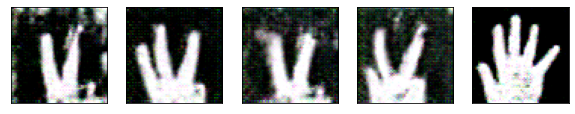

  0%|          | 0/32 [00:00<?, ?it/s]

[216/300]
Loss_D: 0.7016	Loss_G: 2.6151



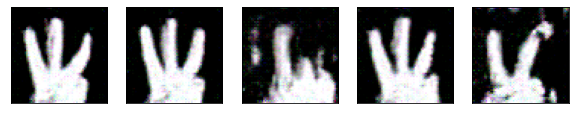

  0%|          | 0/32 [00:00<?, ?it/s]

[217/300]
Loss_D: 0.7591	Loss_G: 1.3598



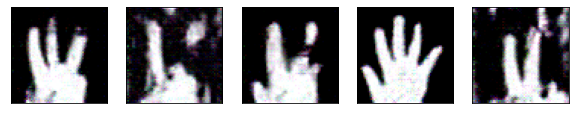

  0%|          | 0/32 [00:00<?, ?it/s]

[218/300]
Loss_D: 0.7202	Loss_G: 2.4912



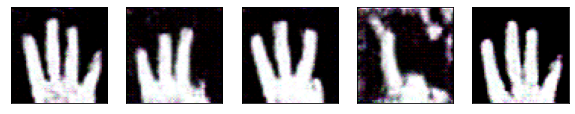

  0%|          | 0/32 [00:00<?, ?it/s]

[219/300]
Loss_D: 0.7883	Loss_G: 1.9050



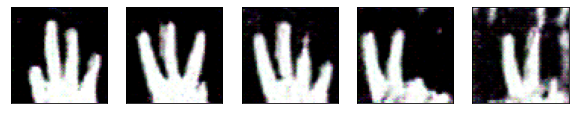

  0%|          | 0/32 [00:00<?, ?it/s]

[220/300]
Loss_D: 0.7446	Loss_G: 1.6997



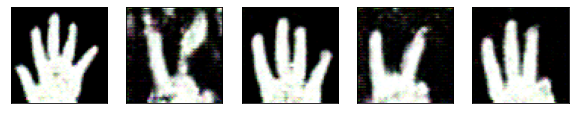

  0%|          | 0/32 [00:00<?, ?it/s]

[221/300]
Loss_D: 0.7192	Loss_G: 2.3912



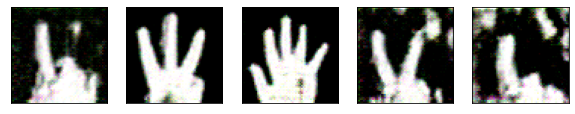

  0%|          | 0/32 [00:00<?, ?it/s]

[222/300]
Loss_D: 0.9634	Loss_G: 0.5259



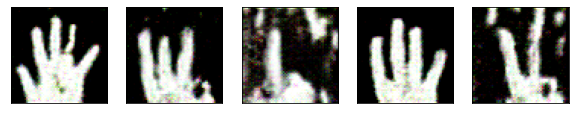

  0%|          | 0/32 [00:00<?, ?it/s]

[223/300]
Loss_D: 0.7402	Loss_G: 2.2055



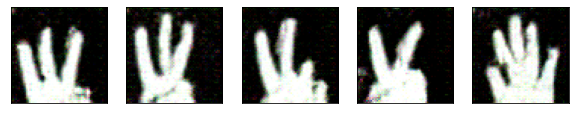

  0%|          | 0/32 [00:00<?, ?it/s]

[224/300]
Loss_D: 0.7124	Loss_G: 1.4124



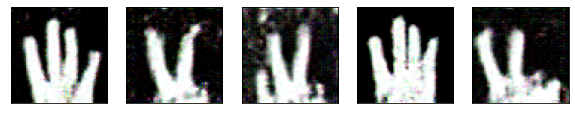

  0%|          | 0/32 [00:00<?, ?it/s]

[225/300]
Loss_D: 0.7110	Loss_G: 1.9979



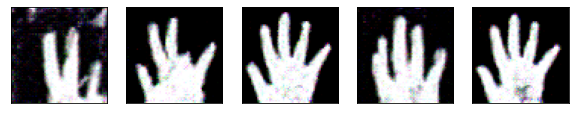

  0%|          | 0/32 [00:00<?, ?it/s]

[226/300]
Loss_D: 0.6722	Loss_G: 1.8408



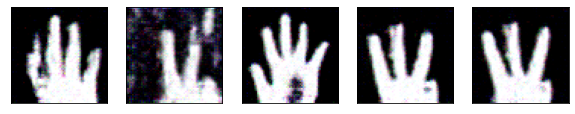

  0%|          | 0/32 [00:00<?, ?it/s]

[227/300]
Loss_D: 0.9009	Loss_G: 0.9105



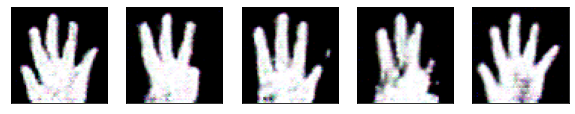

  0%|          | 0/32 [00:00<?, ?it/s]

[228/300]
Loss_D: 0.6773	Loss_G: 2.1410



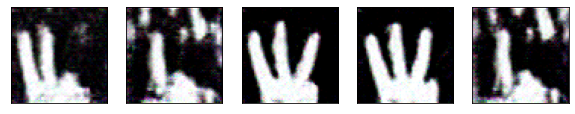

  0%|          | 0/32 [00:00<?, ?it/s]

[229/300]
Loss_D: 0.6836	Loss_G: 2.6169



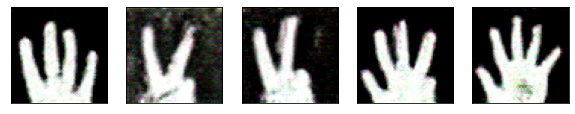

  0%|          | 0/32 [00:00<?, ?it/s]

[230/300]
Loss_D: 0.6700	Loss_G: 2.6053



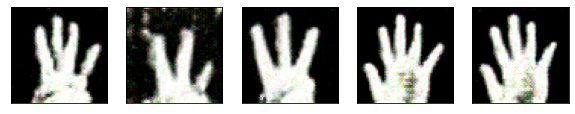

  0%|          | 0/32 [00:00<?, ?it/s]

[231/300]
Loss_D: 0.6798	Loss_G: 2.8573



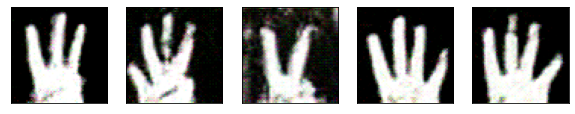

  0%|          | 0/32 [00:00<?, ?it/s]

[232/300]
Loss_D: 0.6731	Loss_G: 3.5923



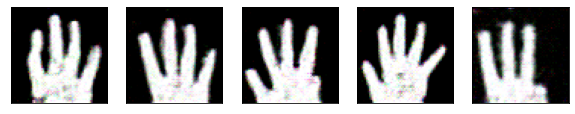

  0%|          | 0/32 [00:00<?, ?it/s]

[233/300]
Loss_D: 0.7173	Loss_G: 1.7817



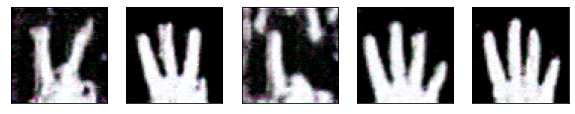

  0%|          | 0/32 [00:00<?, ?it/s]

[234/300]
Loss_D: 0.6611	Loss_G: 2.2769



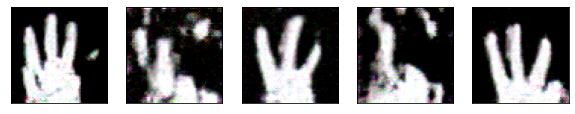

  0%|          | 0/32 [00:00<?, ?it/s]

[235/300]
Loss_D: 0.6847	Loss_G: 2.7602



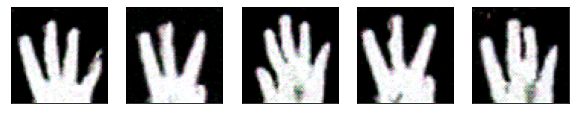

  0%|          | 0/32 [00:00<?, ?it/s]

[236/300]
Loss_D: 0.6785	Loss_G: 2.1811



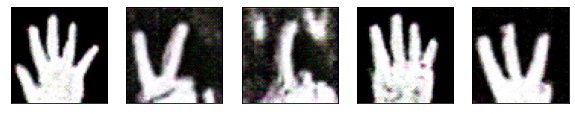

  0%|          | 0/32 [00:00<?, ?it/s]

[237/300]
Loss_D: 1.4701	Loss_G: 0.4425



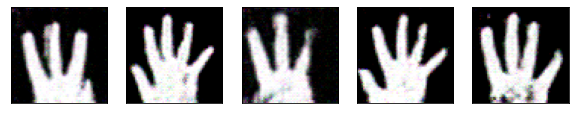

  0%|          | 0/32 [00:00<?, ?it/s]

[238/300]
Loss_D: 0.6901	Loss_G: 2.4781



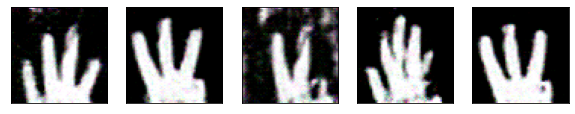

  0%|          | 0/32 [00:00<?, ?it/s]

[239/300]
Loss_D: 0.6711	Loss_G: 3.4793



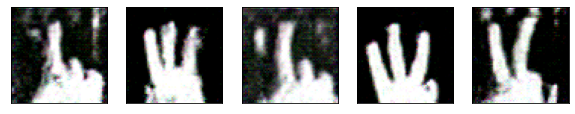

  0%|          | 0/32 [00:00<?, ?it/s]

[240/300]
Loss_D: 0.6596	Loss_G: 2.2190



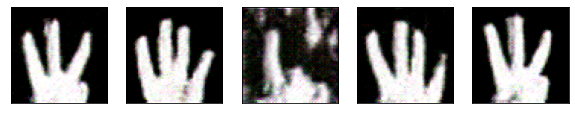

  0%|          | 0/32 [00:00<?, ?it/s]

[241/300]
Loss_D: 0.7165	Loss_G: 2.4919



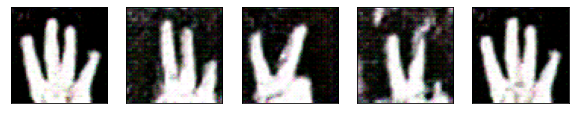

  0%|          | 0/32 [00:00<?, ?it/s]

[242/300]
Loss_D: 0.8104	Loss_G: 1.8715



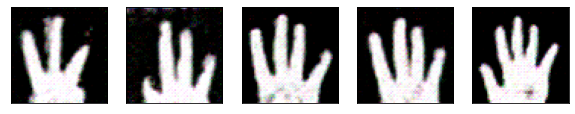

  0%|          | 0/32 [00:00<?, ?it/s]

[243/300]
Loss_D: 0.6533	Loss_G: 3.5043



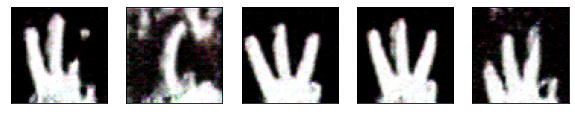

  0%|          | 0/32 [00:00<?, ?it/s]

[244/300]
Loss_D: 0.7295	Loss_G: 1.9383



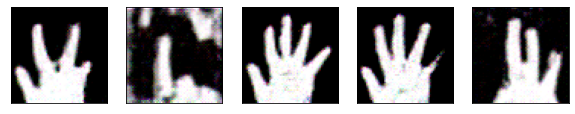

  0%|          | 0/32 [00:00<?, ?it/s]

[245/300]
Loss_D: 0.7029	Loss_G: 1.9896



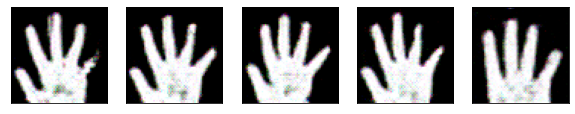

  0%|          | 0/32 [00:00<?, ?it/s]

[246/300]
Loss_D: 0.7482	Loss_G: 1.9587



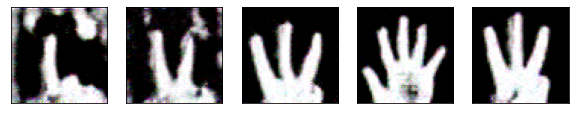

  0%|          | 0/32 [00:00<?, ?it/s]

[247/300]
Loss_D: 0.7383	Loss_G: 1.1709



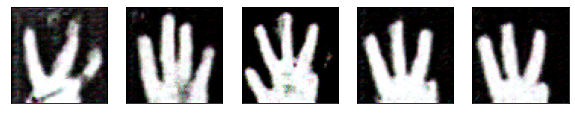

  0%|          | 0/32 [00:00<?, ?it/s]

[248/300]
Loss_D: 0.6926	Loss_G: 1.7067



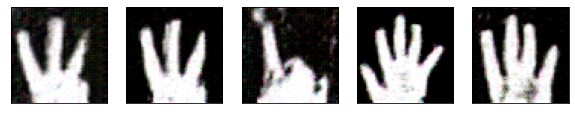

  0%|          | 0/32 [00:00<?, ?it/s]

[249/300]
Loss_D: 0.7329	Loss_G: 1.7571



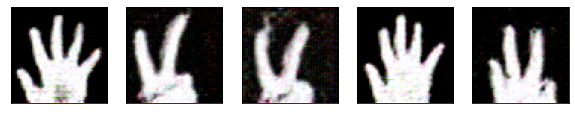

  0%|          | 0/32 [00:00<?, ?it/s]

[250/300]
Loss_D: 0.6652	Loss_G: 2.3003



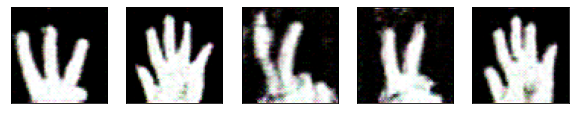

  0%|          | 0/32 [00:00<?, ?it/s]

[251/300]
Loss_D: 0.8680	Loss_G: 1.7880



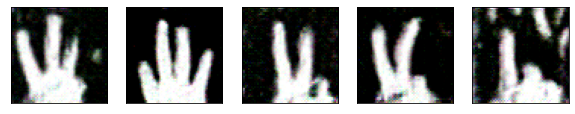

  0%|          | 0/32 [00:00<?, ?it/s]

[252/300]
Loss_D: 0.6394	Loss_G: 2.6289



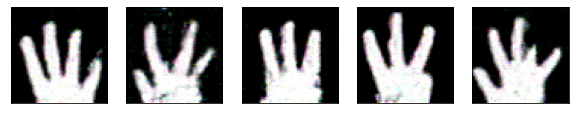

  0%|          | 0/32 [00:00<?, ?it/s]

[253/300]
Loss_D: 0.7829	Loss_G: 1.6927



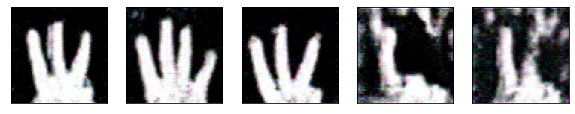

  0%|          | 0/32 [00:00<?, ?it/s]

[254/300]
Loss_D: 0.6785	Loss_G: 2.8353



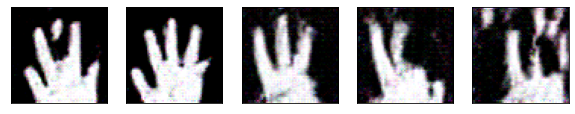

  0%|          | 0/32 [00:00<?, ?it/s]

[255/300]
Loss_D: 0.8711	Loss_G: 2.1722



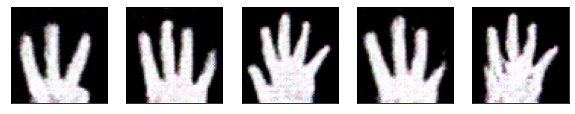

  0%|          | 0/32 [00:00<?, ?it/s]

[256/300]
Loss_D: 0.6608	Loss_G: 2.7083



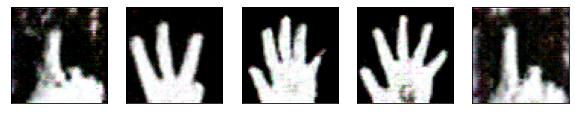

  0%|          | 0/32 [00:00<?, ?it/s]

[257/300]
Loss_D: 0.6653	Loss_G: 2.4902



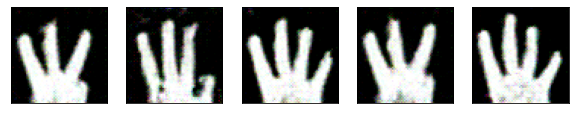

  0%|          | 0/32 [00:00<?, ?it/s]

[258/300]
Loss_D: 0.6645	Loss_G: 2.7652



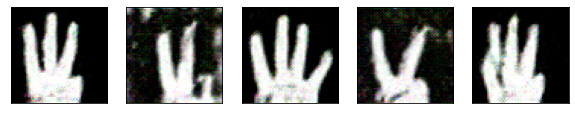

  0%|          | 0/32 [00:00<?, ?it/s]

[259/300]
Loss_D: 0.6518	Loss_G: 2.2812



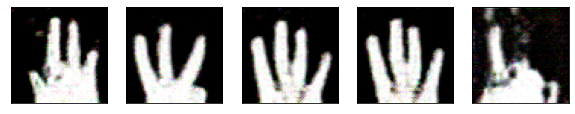

  0%|          | 0/32 [00:00<?, ?it/s]

[260/300]
Loss_D: 0.6782	Loss_G: 1.6140



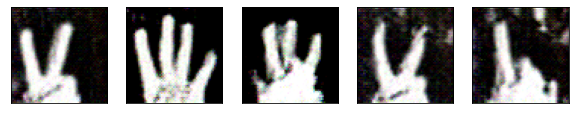

  0%|          | 0/32 [00:00<?, ?it/s]

[261/300]
Loss_D: 0.7281	Loss_G: 1.6091



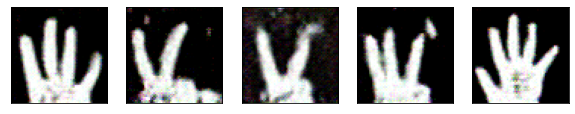

  0%|          | 0/32 [00:00<?, ?it/s]

[262/300]
Loss_D: 0.6406	Loss_G: 3.4756



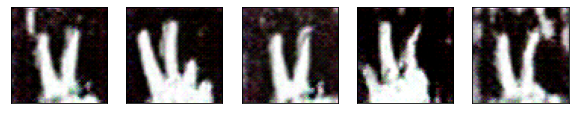

  0%|          | 0/32 [00:00<?, ?it/s]

[263/300]
Loss_D: 0.7738	Loss_G: 2.1819



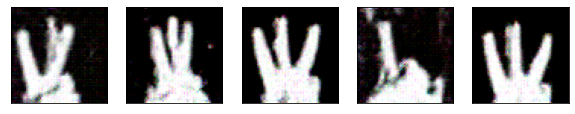

  0%|          | 0/32 [00:00<?, ?it/s]

[264/300]
Loss_D: 0.6672	Loss_G: 2.7850



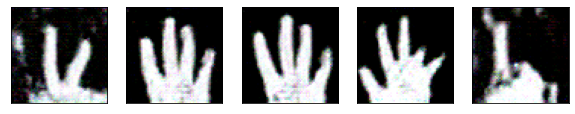

  0%|          | 0/32 [00:00<?, ?it/s]

[265/300]
Loss_D: 0.6444	Loss_G: 3.1003



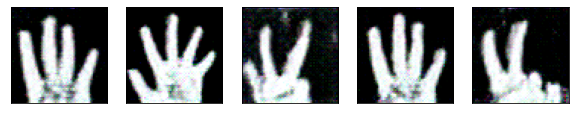

  0%|          | 0/32 [00:00<?, ?it/s]

[266/300]
Loss_D: 0.6969	Loss_G: 1.6763



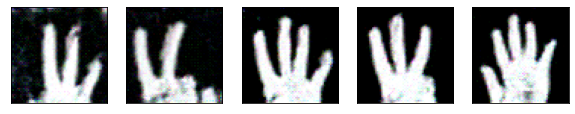

  0%|          | 0/32 [00:00<?, ?it/s]

[267/300]
Loss_D: 0.7285	Loss_G: 1.8566



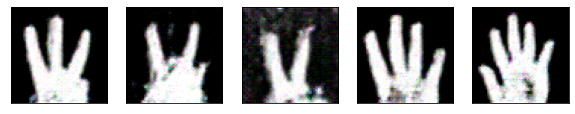

  0%|          | 0/32 [00:00<?, ?it/s]

[268/300]
Loss_D: 0.6814	Loss_G: 3.6081



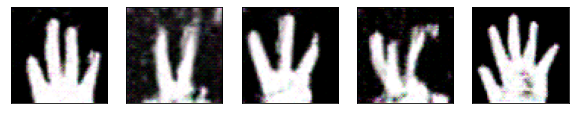

  0%|          | 0/32 [00:00<?, ?it/s]

[269/300]
Loss_D: 0.6667	Loss_G: 3.0560



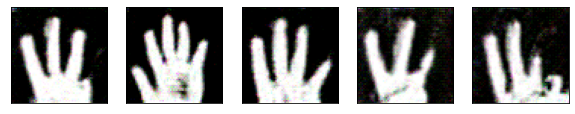

  0%|          | 0/32 [00:00<?, ?it/s]

[270/300]
Loss_D: 0.7179	Loss_G: 2.8572



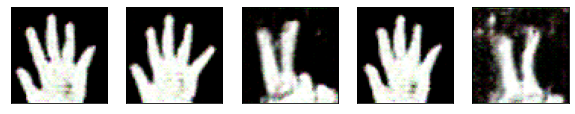

  0%|          | 0/32 [00:00<?, ?it/s]

[271/300]
Loss_D: 0.6509	Loss_G: 2.1738



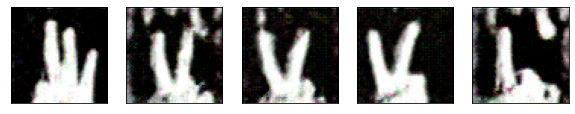

  0%|          | 0/32 [00:00<?, ?it/s]

[272/300]
Loss_D: 0.6301	Loss_G: 3.7723



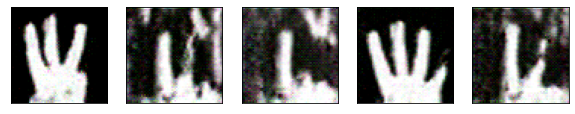

  0%|          | 0/32 [00:00<?, ?it/s]

[273/300]
Loss_D: 0.6803	Loss_G: 2.3943



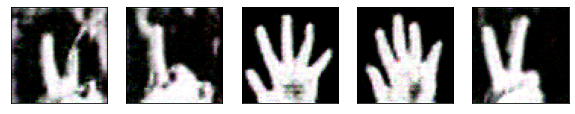

  0%|          | 0/32 [00:00<?, ?it/s]

[274/300]
Loss_D: 0.6414	Loss_G: 3.6475



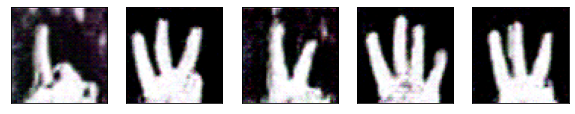

  0%|          | 0/32 [00:00<?, ?it/s]

[275/300]
Loss_D: 0.7068	Loss_G: 1.9737



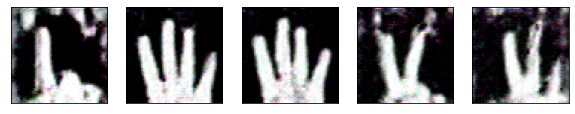

  0%|          | 0/32 [00:00<?, ?it/s]

[276/300]
Loss_D: 0.6792	Loss_G: 2.3200



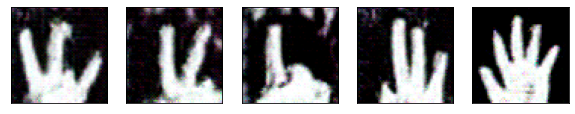

  0%|          | 0/32 [00:00<?, ?it/s]

[277/300]
Loss_D: 0.6465	Loss_G: 2.5993



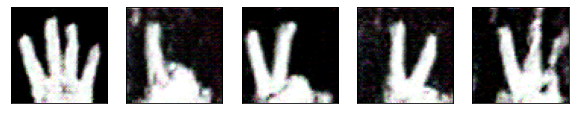

  0%|          | 0/32 [00:00<?, ?it/s]

[278/300]
Loss_D: 0.6869	Loss_G: 2.0321



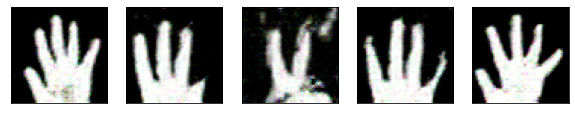

  0%|          | 0/32 [00:00<?, ?it/s]

[279/300]
Loss_D: 0.7011	Loss_G: 1.8892



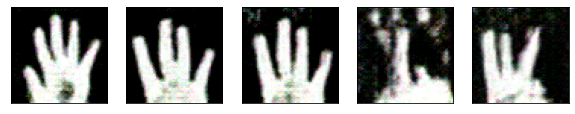

  0%|          | 0/32 [00:00<?, ?it/s]

[280/300]
Loss_D: 0.6448	Loss_G: 2.9017



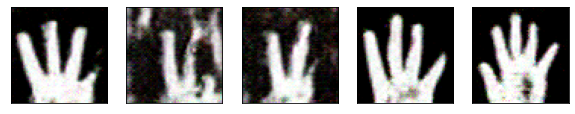

  0%|          | 0/32 [00:00<?, ?it/s]

[281/300]
Loss_D: 0.7186	Loss_G: 1.7405



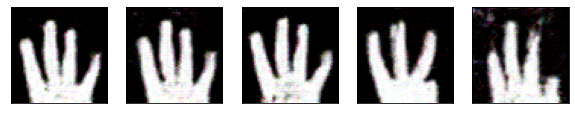

  0%|          | 0/32 [00:00<?, ?it/s]

[282/300]
Loss_D: 0.6408	Loss_G: 2.3027



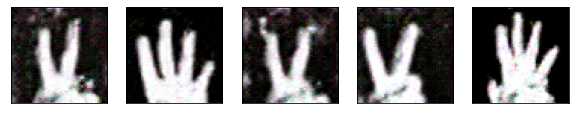

  0%|          | 0/32 [00:00<?, ?it/s]

[283/300]
Loss_D: 0.7798	Loss_G: 2.3518



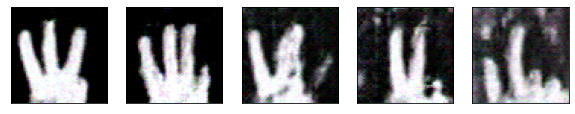

  0%|          | 0/32 [00:00<?, ?it/s]

[284/300]
Loss_D: 0.7074	Loss_G: 1.8814



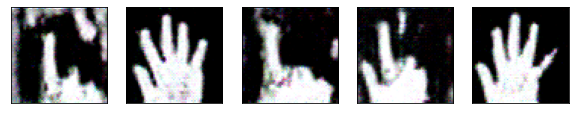

  0%|          | 0/32 [00:00<?, ?it/s]

[285/300]
Loss_D: 0.7099	Loss_G: 2.1525



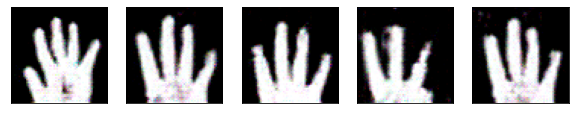

  0%|          | 0/32 [00:00<?, ?it/s]

[286/300]
Loss_D: 0.6726	Loss_G: 1.8623



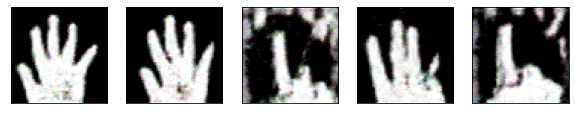

  0%|          | 0/32 [00:00<?, ?it/s]

[287/300]
Loss_D: 0.7053	Loss_G: 2.3527



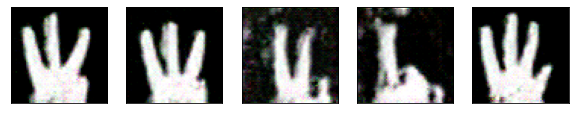

  0%|          | 0/32 [00:00<?, ?it/s]

[288/300]
Loss_D: 0.7409	Loss_G: 2.1740



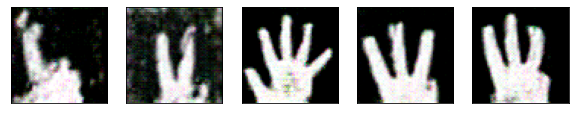

  0%|          | 0/32 [00:00<?, ?it/s]

[289/300]
Loss_D: 0.6725	Loss_G: 2.0126



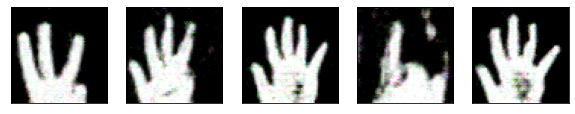

  0%|          | 0/32 [00:00<?, ?it/s]

[290/300]
Loss_D: 0.6677	Loss_G: 1.9131



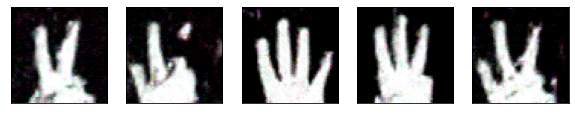

  0%|          | 0/32 [00:00<?, ?it/s]

[291/300]
Loss_D: 0.6563	Loss_G: 3.1555



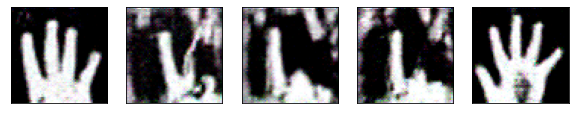

  0%|          | 0/32 [00:00<?, ?it/s]

[292/300]
Loss_D: 0.6434	Loss_G: 3.1397



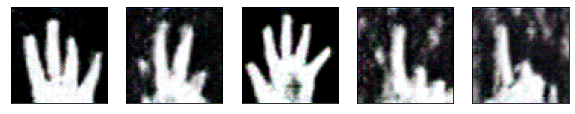

  0%|          | 0/32 [00:00<?, ?it/s]

[293/300]
Loss_D: 0.6472	Loss_G: 2.4258



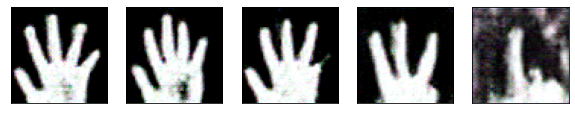

  0%|          | 0/32 [00:00<?, ?it/s]

[294/300]
Loss_D: 0.7229	Loss_G: 2.1127



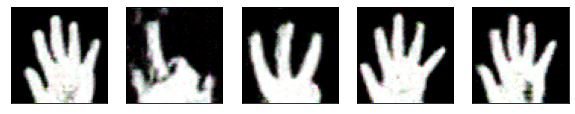

  0%|          | 0/32 [00:00<?, ?it/s]

[295/300]
Loss_D: 0.7179	Loss_G: 2.2864



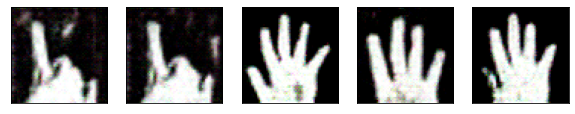

  0%|          | 0/32 [00:00<?, ?it/s]

[296/300]
Loss_D: 0.6575	Loss_G: 2.4273



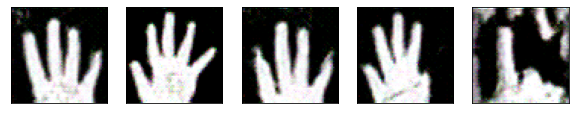

  0%|          | 0/32 [00:00<?, ?it/s]

[297/300]
Loss_D: 1.1568	Loss_G: 0.9598



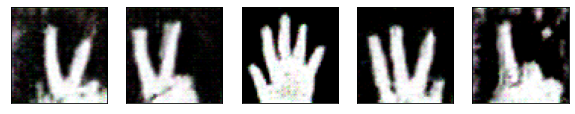

  0%|          | 0/32 [00:00<?, ?it/s]

[298/300]
Loss_D: 0.7077	Loss_G: 1.9324



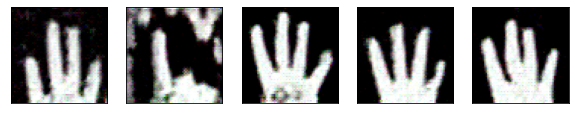

  0%|          | 0/32 [00:00<?, ?it/s]

[299/300]
Loss_D: 0.7180	Loss_G: 1.7403



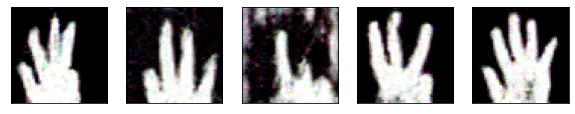

  0%|          | 0/32 [00:00<?, ?it/s]

[300/300]
Loss_D: 0.6417	Loss_G: 2.6589



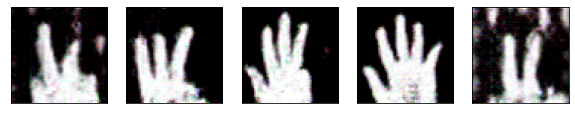

In [ ]:
G_losses = []
D_losses = []
Acc_D=np.zeros(300)
Acc_G=np.zeros(300)

for epoch in range(300):
    acc_D=[]
    acc_G=[]
    for i, data in enumerate(tqdm.notebook.tqdm(dataloader)):
        # prepare real image and label
        real_image = data[0].to(device)
        real_label = data[1].to(device)
        b_size = real_label.size(0)      
        
        # prepare fake image and label
        fake_label = torch.randint(n_class, (b_size,), dtype=torch.long, device=device)
        noise = torch.randn(b_size, 128, 1, 1, device=device).squeeze(0)
        onehotnoise_label = torch.eye(n_class, device=device) [real_label].view(-1, n_class, 1, 1)
        noise = torch.cat((noise, onehotnoise_label), dim=1) 
        fake_image = netG(noise)
        
        # target
        real_target = torch.full((b_size,), r_label, device=device)
        fake_target = torch.full((b_size,), f_label, device=device)
        
        # Update Discriminator
        netD.zero_grad()
        # train with real
        s_output, c_output = netD(real_image)
        s_output=s_output.squeeze(1)
        c_output=c_output.squeeze(1)
        s_errD_real = s_criterion(s_output, real_target)  # realfake
        c_errD_real = c_criterion(c_output, real_label)  # class
        errD_real = s_errD_real + c_errD_real
        errD_real.backward()
        # train with fake
        s_output_f,c_output_f = netD(fake_image.detach())
        s_output_f=s_output_f.squeeze(1)
        c_output_f=c_output_f.squeeze(1)
        s_errD_fake = s_criterion(s_output_f, fake_target.float())  # realfake
        c_errD_fake = c_criterion(c_output_f, real_label)  # class
        errD_fake = s_errD_fake + c_errD_fake
        errD_fake.backward()
        errD = s_errD_real + s_errD_fake
        optimizerD.step()
        pred = np.concatenate([s_output.data.cpu().numpy(), s_output_f.data.cpu().numpy()], axis=0)
        gt = np.concatenate([real_target.data.cpu().numpy(), fake_target.data.cpu().numpy()], axis=0)
        acc_D.append(np.mean(np.argmax(pred) == gt))    

        # Update Generator
        netG.zero_grad()
        s_output,c_output = netD(fake_image)
        s_output=s_output.squeeze(1)
        c_output=c_output.squeeze(1)
        s_errG = s_criterion(s_output, real_target)  # realfake
        c_errG = c_criterion(c_output, real_label)  # class
        errG = s_errG + c_errG
        errG.backward()
        optimizerG.step() 

        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
    acc_D=np.mean(acc_D)
    Acc_D[epoch]=acc_D

    print('[%d/%d]\nLoss_D: %.4f\tLoss_G: %.4f\n'
          % (epoch+1, num_epochs,errD.item(), errG.item()))
   
    gen_images = []
    for _ in range(5):
        noise = torch.randn(1, 128, 1, 1, device=device)
        label = torch.randint(0, n_class, (1, ), device=device)
        onehot_label = torch.eye(n_class, device=device) [label].view(-1, n_class, 1, 1)
        gen_image = torch.cat((noise, onehot_label), dim=1)
        gen_image = netG(gen_image).to("cpu").clone().detach().squeeze(0)
        gen_image = gen_image.numpy().transpose(1, 2, 0)
        gen_images.append(gen_image)
    fig = plt.figure(figsize=(10, 5))
    for i, gen_image in enumerate(gen_images):
        ax = fig.add_subplot(1, 5, i + 1, xticks=[], yticks=[])
        plt.imshow(gen_image + 1 / 2)
    plt.show()



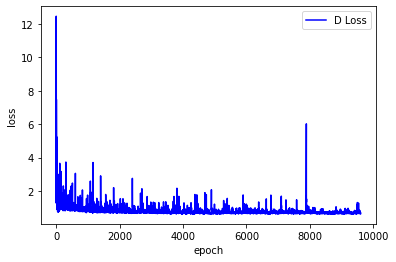

In [ ]:
plt.figure()
plt.plot(D_losses,c='b',label="D Loss")
plt.legend()
plt.xlabel("epoch")
plt.ylabel("loss")
plt.show()

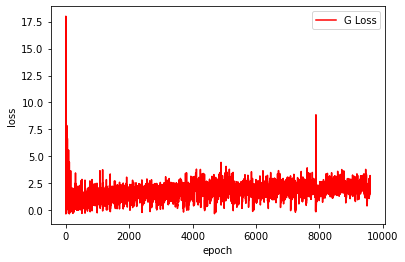

In [ ]:
plt.figure()
plt.plot(G_losses,c='r',label="G Loss")
plt.legend()
plt.xlabel("epoch")
plt.ylabel("loss")
# plt.set_ylim(0,4)
plt.show()

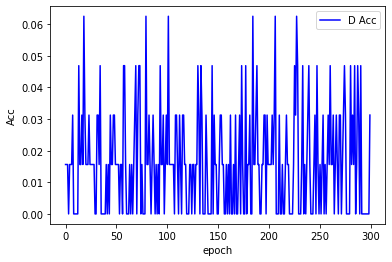

In [ ]:
plt.figure()
plt.plot(Acc_D,c='b',label="D Acc")
plt.legend()
plt.xlabel("epoch")
plt.ylabel("Acc")
plt.show()